# 1. Introduction and Project Scope

## 1.1 Problem Statement

Supply chain industries often struggle with late deliveries and fraudulent orders, leading to inefficiencies and financial losses. This project aims to tackle these challenges by leveraging machine learning to identify patterns in order history, supplier reliability, and transaction anomalies that signal potential delays or fraud. Machine learning provides the ability to predict delivery performance and detect suspicious activities based on historical data. By applying predictive models to past supply chain records, we can enhance logistics planning, reduce fraud risks, and optimize resource allocation. Machine learning has proven effective in improving supply chain reliability by enabling proactive, data-driven decision-making that minimizes disruptions and enhances overall efficiency.https://data.mendeley.com/datasets/8gx2fvg2k6/5

## 1.2 Objectives

The primary goal of this project is to predict which orders are most likely to face delivery delays or be fraudulent, enabling more proactive and efficient supply chain management.

To achieve this, we will analyze historical supply chain data, including order volume, supplier reliability, shipping times, transaction anomalies, and past instances of fraud. We will use several machine learning models and a neural network model to train and test the data. After evaluating the models' performance, the best-performing model will be selected to predict potential delays and fraudulent orders in future transactions.

## 1.3 Data Description

For this project, we use a supply chain dataset (https://data.mendeley.com/datasets/8gx2fvg2k6/5) by Constante, Silva, and Pereira (2019). The data is related a supply chain company. The code within this project refers to a Kaggle Project (https://www.kaggle.com/code/skloveyyp/comparison-of-classification-regression-rnn) by Shu (2021).

# 2. Data Overview and Project Preparation

## 2.1 Import Libraries

In [1]:
# install libraries if needed

!pip install xgboost
!pip install keras
!pip install statsmodels
!pip install lightgbm
!pip install tensorflow
!pip install folium
!pip install imblearn

In [3]:
# Import required libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import xgboost as xgb
import datetime as dt
import matplotlib
from datetime import datetime
import folium

import keras

# Scikit-learn modules
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict, RandomizedSearchCV
from sklearn import svm, metrics, tree, preprocessing, linear_model
from sklearn.preprocessing import MinMaxScaler, StandardScaler, LabelEncoder
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from sklearn.metrics import (
    accuracy_score, mean_squared_error, precision_score, recall_score,
    confusion_matrix, f1_score, roc_curve, auc
)
from sklearn.tree import DecisionTreeClassifier
from sklearn.cluster import KMeans
from sklearn.utils import resample
from sklearn.decomposition import PCA
from imblearn.over_sampling import SMOTE
from sklearn.utils.class_weight import compute_class_weight

# Deep learning modules
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.optimizers import Adam, RMSprop

# Other visualization tools
import plotly.express as px

# Collections
from collections import Counter

# Config df display
pd.set_option('display.max_columns', None)


2025-03-06 17:19:33.363415: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-03-06 17:19:33.367946: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-03-06 17:19:33.382932: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1741281573.409652   10593 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1741281573.428964   10593 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-03-06 17:19:33.465457: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU ins

## 2.2 Loading Data

In [4]:
#Importing Dataset using pandas
dataset=pd.read_csv("DataCoSupplyChainDataset.csv",header= 0,encoding= 'unicode_escape')
print(dataset.shape)

(180519, 53)


In [5]:
dataset.head(5)

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Email,Customer Fname,Customer Id,Customer Lname,Customer Password,Customer Segment,Customer State,Customer Street,Customer Zipcode,Department Id,Department Name,Latitude,Longitude,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Image,Product Name,Product Price,Product Status,shipping date (DateOrders),Shipping Mode
0,DEBIT,3,4,91.250000,314.640015,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,XXXXXXXXX,Cally,20755,Holloway,XXXXXXXXX,Consumer,PR,5365 Noble Nectar Island,725.0,2,Fitness,18.251453,-66.037056,Pacific Asia,Bekasi,Indonesia,20755,1/31/2018 22:56,77202,1360,13.110000,0.04,180517,327.75,0.29,1,327.75,314.640015,91.250000,Southeast Asia,Java Occidental,COMPLETE,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,2/3/2018 22:56,Standard Class
1,TRANSFER,5,4,-249.089996,311.359985,Late delivery,1,73,Sporting Goods,Caguas,Puerto Rico,XXXXXXXXX,Irene,19492,Luna,XXXXXXXXX,Consumer,PR,2679 Rustic Loop,725.0,2,Fitness,18.279451,-66.037064,Pacific Asia,Bikaner,India,19492,1/13/2018 12:27,75939,1360,16.389999,0.05,179254,327.75,-0.80,1,327.75,311.359985,-249.089996,South Asia,Rajastán,PENDING,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/18/2018 12:27,Standard Class
2,CASH,4,4,-247.779999,309.720001,Shipping on time,0,73,Sporting Goods,San Jose,EE. UU.,XXXXXXXXX,Gillian,19491,Maldonado,XXXXXXXXX,Consumer,CA,8510 Round Bear Gate,95125.0,2,Fitness,37.292233,-121.881279,Pacific Asia,Bikaner,India,19491,1/13/2018 12:06,75938,1360,18.030001,0.06,179253,327.75,-0.80,1,327.75,309.720001,-247.779999,South Asia,Rajastán,CLOSED,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/17/2018 12:06,Standard Class
3,DEBIT,3,4,22.860001,304.809998,Advance shipping,0,73,Sporting Goods,Los Angeles,EE. UU.,XXXXXXXXX,Tana,19490,Tate,XXXXXXXXX,Home Office,CA,3200 Amber Bend,90027.0,2,Fitness,34.125946,-118.291016,Pacific Asia,Townsville,Australia,19490,1/13/2018 11:45,75937,1360,22.940001,0.07,179252,327.75,0.08,1,327.75,304.809998,22.860001,Oceania,Queensland,COMPLETE,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/16/2018 11:45,Standard Class
4,PAYMENT,2,4,134.210007,298.250000,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,XXXXXXXXX,Orli,19489,Hendricks,XXXXXXXXX,Corporate,PR,8671 Iron Anchor Corners,725.0,2,Fitness,18.253769,-66.037048,Pacific Asia,Townsville,Australia,19489,1/13/2018 11:24,75936,1360,29.500000,0.09,179251,327.75,0.45,1,327.75,298.250000,134.210007,Oceania,Queensland,PENDING_PAYMENT,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.75,0,1/15/2018 11:24,Standard Class


In [6]:
dataset['Late_delivery_risk'].value_counts()

Late_delivery_risk
1    98977
0    81542
Name: count, dtype: int64

In [7]:
dataset['Order Status'].value_counts()

Order Status
COMPLETE           59491
PENDING_PAYMENT    39832
PROCESSING         21902
PENDING            20227
CLOSED             19616
ON_HOLD             9804
SUSPECTED_FRAUD     4062
CANCELED            3692
PAYMENT_REVIEW      1893
Name: count, dtype: int64

In [8]:
dataset['Delivery Status'].value_counts()

Delivery Status
Late delivery        98977
Advance shipping     41592
Shipping on time     32196
Shipping canceled     7754
Name: count, dtype: int64

## 2.3 Data Initial Check

In [9]:
dataset.shape

(180519, 53)

In [10]:
dataset.apply(lambda x: sum(x.isnull()))

Type                                  0
Days for shipping (real)              0
Days for shipment (scheduled)         0
Benefit per order                     0
Sales per customer                    0
Delivery Status                       0
Late_delivery_risk                    0
Category Id                           0
Category Name                         0
Customer City                         0
Customer Country                      0
Customer Email                        0
Customer Fname                        0
Customer Id                           0
Customer Lname                        8
Customer Password                     0
Customer Segment                      0
Customer State                        0
Customer Street                       0
Customer Zipcode                      3
Department Id                         0
Department Name                       0
Latitude                              0
Longitude                             0
Market                                0


The data consist of some null values in Customer Lname, Customer Zipcode, Order Zipcode, and Product Description. There are to much null values in Order Zipcode and Product Description and we will drop them later. Null Values in Customer Zipcode will be placed by 0. We won't do anything for null values in Customer Lname since there is no null values in Customer Fname anyway, and we will merge them into Customer Full Name

In [11]:
#Merge Customer Fname and Customer Lname into Customer Full Name
dataset['Customer Full Name'] = dataset['Customer Fname'].astype(str)+dataset['Customer Lname'].astype(str)

#Filling Nan values in Customer Zipcode with 0
dataset['Customer Zipcode']=dataset['Customer Zipcode'].fillna(0)

dataset

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Email,Customer Fname,Customer Id,Customer Lname,Customer Password,Customer Segment,Customer State,Customer Street,Customer Zipcode,Department Id,Department Name,Latitude,Longitude,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Order Zipcode,Product Card Id,Product Category Id,Product Description,Product Image,Product Name,Product Price,Product Status,shipping date (DateOrders),Shipping Mode,Customer Full Name
0,DEBIT,3,4,91.250000,314.640015,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,XXXXXXXXX,Cally,20755,Holloway,XXXXXXXXX,Consumer,PR,5365 Noble Nectar Island,725.0,2,Fitness,18.251453,-66.037056,Pacific Asia,Bekasi,Indonesia,20755,1/31/2018 22:56,77202,1360,13.110000,0.04,180517,327.750000,0.29,1,327.750000,314.640015,91.250000,Southeast Asia,Java Occidental,COMPLETE,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.750000,0,2/3/2018 22:56,Standard Class,CallyHolloway
1,TRANSFER,5,4,-249.089996,311.359985,Late delivery,1,73,Sporting Goods,Caguas,Puerto Rico,XXXXXXXXX,Irene,19492,Luna,XXXXXXXXX,Consumer,PR,2679 Rustic Loop,725.0,2,Fitness,18.279451,-66.037064,Pacific Asia,Bikaner,India,19492,1/13/2018 12:27,75939,1360,16.389999,0.05,179254,327.750000,-0.80,1,327.750000,311.359985,-249.089996,South Asia,Rajastán,PENDING,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.750000,0,1/18/2018 12:27,Standard Class,IreneLuna
2,CASH,4,4,-247.779999,309.720001,Shipping on time,0,73,Sporting Goods,San Jose,EE. UU.,XXXXXXXXX,Gillian,19491,Maldonado,XXXXXXXXX,Consumer,CA,8510 Round Bear Gate,95125.0,2,Fitness,37.292233,-121.881279,Pacific Asia,Bikaner,India,19491,1/13/2018 12:06,75938,1360,18.030001,0.06,179253,327.750000,-0.80,1,327.750000,309.720001,-247.779999,South Asia,Rajastán,CLOSED,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.750000,0,1/17/2018 12:06,Standard Class,GillianMaldonado
3,DEBIT,3,4,22.860001,304.809998,Advance shipping,0,73,Sporting Goods,Los Angeles,EE. UU.,XXXXXXXXX,Tana,19490,Tate,XXXXXXXXX,Home Office,CA,3200 Amber Bend,90027.0,2,Fitness,34.125946,-118.291016,Pacific Asia,Townsville,Australia,19490,1/13/2018 11:45,75937,1360,22.940001,0.07,179252,327.750000,0.08,1,327.750000,304.809998,22.860001,Oceania,Queensland,COMPLETE,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.750000,0,1/16/2018 11:45,Standard Class,TanaTate
4,PAYMENT,2,4,134.210007,298.250000,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,XXXXXXXXX,Orli,19489,Hendricks,XXXXXXXXX,Corporate,PR,8671 Iron Anchor Corners,725.0,2,Fitness,18.253769,-66.037048,Pacific Asia,Townsville,Australia,19489,1/13/2018 11:24,75936,1360,29.500000,0.09,179251,327.750000,0.45,1,327.750000,298.250000,134.210007,Oceania,Queensland,PENDING_PAYMENT,NaN,1360,73,NaN,http://images.acmesports.sports/Smart+watch,Smart watch,327.750000,0,1/15/2018 11:24,Standard Class,OrliHendricks
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
180514,CASH,4,4,40.000000,399.980011,Shipping on time,0,45,Fishing,Brooklyn,EE. UU.,XXXXXXXXX,Maria,1005,Peterson,XXXXXXXXX,Home Office,NY,1322 Broad Glade,11207.0,7,Fan Shop,40.640930,-73.942711,Pacific Asia,Shanghái,China,1005,1/16/2016 3:40,26043,1004,0.000000,0.00,65177,399.980011,0.10,1,399.980011,399.980011,40.000000,Eastern Asia,Shanghái,CLOSED,NaN,1004,45,NaN,http://images.acmesports.sports/Fi

# 3. Exploratory Data Analysis

## 3.1 Geographic Data

In [12]:
dataset.groupby(['Market', 'Order City']).size().reset_index(name='count').sort_values(by='count', ascending=False)

,Market,Order City,count
2111,LATAM,Santo Domingo,2211
3433,USCA,New York City,2202
3368,USCA,Los Angeles,1845
2154,LATAM,Tegucigalpa,1783
1913,LATAM,Managua,1682
...,...,...,...
2194,LATAM,Vilhena,1
3600,USCA,Tinley Park,1
3620,USCA,Warner Robins,1
3649,USCA,Yucaipa,1


In [13]:
dataset['Customer City'].value_counts()

Customer City
Caguas         66770
Chicago         3885
Los Angeles     3417
Brooklyn        3412
New York        1816
               ...  
Bartlett          25
Ponce             22
Malden            22
Freehold          13
CA                 3
Name: count, Length: 563, dtype: int64

In [14]:
dataset[dataset['Order Status'] == 'SUSPECTED_FRAUD'].groupby('Customer City').size().reset_index(name='fraud_count').sort_values(by='fraud_count', ascending=False)

,Customer City,fraud_count
41,Caguas,1583
54,Chicago,80
185,Los Angeles,72
35,Brooklyn,55
252,Philadelphia,42
...,...,...
38,Buena Park,1
288,Saint Peters,1
45,Carmichael,1
52,Chapel Hill,1


In [15]:
dataset['Market'].value_counts()

Market
LATAM           51594
Europe          50252
Pacific Asia    41260
USCA            25799
Africa          11614
Name: count, dtype: int64

Based on Order City and Customer City, the order and customer location are all over the world. We will visualize the Latitude and Longitude data, which is the coordinate of the stores.

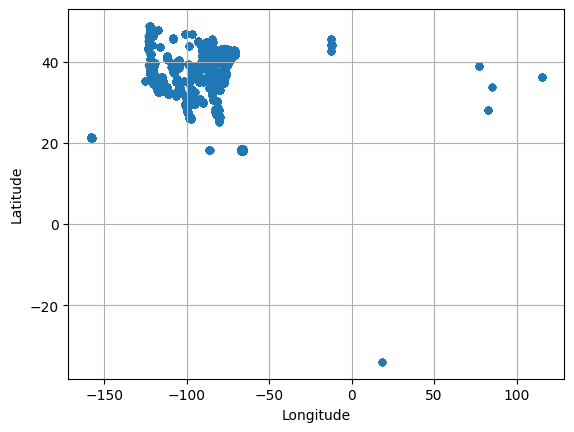

In [16]:
# Plot coordinates to scatter plot
dataset.plot(kind="scatter", x="Longitude", y="Latitude", grid=True)
plt.show()

The plot doesn't show anything meaningful. We will use the actual Latitude and Longitude data and visualize them in a map using folium library. Since the library is quiet heavy, we will only visualize 100 data per market.

In [17]:
dataset['Market'].value_counts()

Market
LATAM           51594
Europe          50252
Pacific Asia    41260
USCA            25799
Africa          11614
Name: count, dtype: int64

In [18]:
# Get market counts 
market_counts = dataset['Market'].value_counts()

# Total current records
total_records = market_counts.sum()

# Target total records
target_records = 5000

# Calculate the proportion for each market
scaling_factors = (market_counts / total_records * target_records).round().astype(int)

# Sample the dataset proportionally
map_dataset = pd.concat([
    dataset[dataset['Market'] == market].sample(n=min(scaling_factors[market], dataset[dataset['Market'] == market].shape[0]), random_state=42)
    for market in scaling_factors.index
])


In [19]:
# Create a Folium Map Centered at the Mean Location
map_center = [map_dataset["Latitude"].mean(), map_dataset["Longitude"].mean()]
my_map = folium.Map(location=map_center, zoom_start=5)

# Add Markers
for index, row in map_dataset.iterrows():
    folium.Marker(
        location=[row["Latitude"], row["Longitude"]],
        popup=row["Customer City"],
        tooltip=row["Customer City"]
    ).add_to(my_map)

# Show the Map
my_map

From the folium Map, we can see that even though the Customer City and Order City are all over the world, most of the stores are located in the American Continent.

## 3.2 Correlation Heatmap

In [20]:
#drop unused columns
data=dataset.drop(['Customer Email','Product Status','Customer Password','Customer Street','Customer Fname','Customer Lname',
           'Latitude','Longitude','Product Description','Product Image','Order Zipcode','shipping date (DateOrders)'],axis=1)
data.shape

(180519, 42)

In [21]:
# Filter only numerical columns
numerical_columns = dataset.select_dtypes(include=['number']).columns
numerical_columns = [col for col in numerical_columns if "Id" not in col and "Latitude" not in col and "Longitude" not in col and "Product Description" not in col and "Product Status" not in col and "Order Zipcode" not in col]
numerical_data = dataset[numerical_columns]

print(numerical_columns)

['Days for shipping (real)', 'Days for shipment (scheduled)', 'Benefit per order', 'Sales per customer', 'Late_delivery_risk', 'Customer Zipcode', 'Order Item Discount', 'Order Item Discount Rate', 'Order Item Product Price', 'Order Item Profit Ratio', 'Order Item Quantity', 'Sales', 'Order Item Total', 'Order Profit Per Order', 'Product Price']


<Axes: >

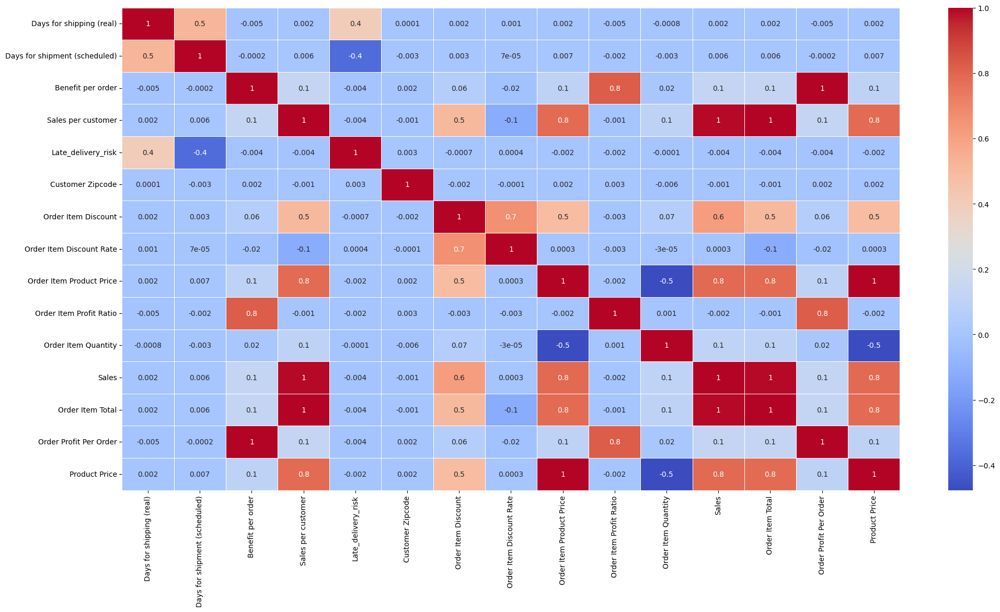

In [22]:
# Visualize correlation with heatmap
fig, ax = plt.subplots(figsize=(24,12))
sns.heatmap(numerical_data.corr(),annot=True,linewidths=.5,fmt='.1g',cmap= 'coolwarm') 

In [23]:
len(numerical_columns)

15

In this part, we want to check the correlation of the variables within the dataset using correlation heatmap. Firstly, we drop unnecessary columns. Secondly, we detect which columns are numerical. There are 29 numerical columns within the dataset. Finally we visualize the correlation using heatmap.

Based on the heatmap, we can see several highly correlated variables. Sales is highly correlated with Product Price, Order Item Discount Rate, and Order Item Total. Days of shipping (real) is highly correlated with Days for shipment (scheduled) and Late_delivery_risk.

## 3.3 Market Overview

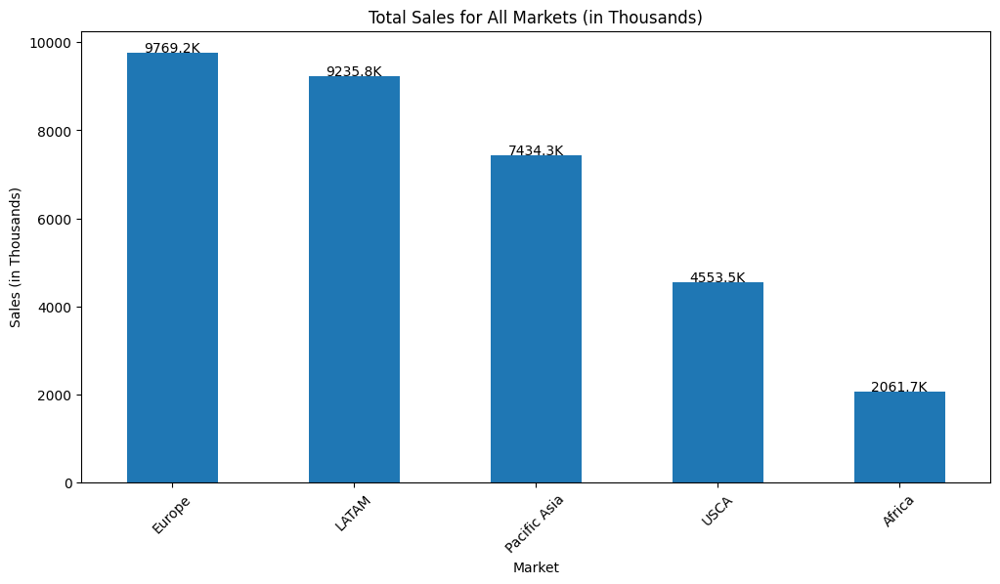

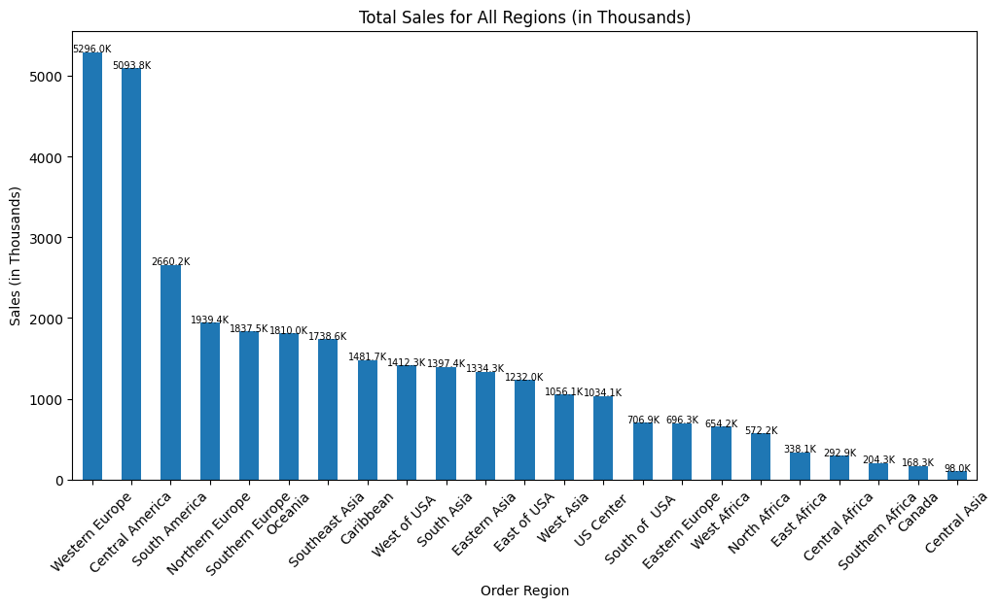

In [24]:
# Total sales per market and region
market = data.groupby('Market') #Grouping by market
region = data.groupby('Order Region')

# Convert sales data to thousands
market_sales = market['Sales per customer'].sum() / 1000  # Convert to thousands
region_sales = region['Sales per customer'].sum() / 1000  # Convert to thousands

# Plot Market Sales
plt.figure(figsize=(12,6))
ax1 = market_sales.sort_values(ascending=False).plot(kind='bar', title="Total Sales for All Markets (in Thousands)")
plt.ylabel("Sales (in Thousands)")

# Adding data labels
for i, v in enumerate(market_sales.sort_values(ascending=False)):
    ax1.text(i, v + 1, f"{v:.1f}K", ha='center')

plt.xticks(rotation=45)
plt.show()

# Plot Region Sales
plt.figure(figsize=(12,6))
ax2 = region_sales.sort_values(ascending=False).plot(kind='bar', title="Total Sales for All Regions (in Thousands)")
plt.ylabel("Sales (in Thousands)")

# Adding data labels
for i, v in enumerate(region_sales.sort_values(ascending=False)):
    ax2.text(i, v + 1, f"{v:.1f}K", ha='center', fontsize=7)

plt.xticks(rotation=45)
plt.show()


In [25]:
dataset.groupby(['Market', 'Order Region']).size().reset_index(name='count')

,Market,Order Region,count
0,Africa,Central Africa,1677
1,Africa,East Africa,1852
2,Africa,North Africa,3232
3,Africa,Southern Africa,1157
4,Africa,West Africa,3696
5,Europe,Eastern Europe,3920
6,Europe,Northern Europe,9792
7,Europe,Southern Europe,9431
8,Europe,Western Europe,27109
9,LATAM,Caribbean,8318


Based on the bargraph above, we can see that Europe market has the most sales. We can also see that based on region, 4 european region are within the top 5, along with South America. Central Asia has the least amount of sales.

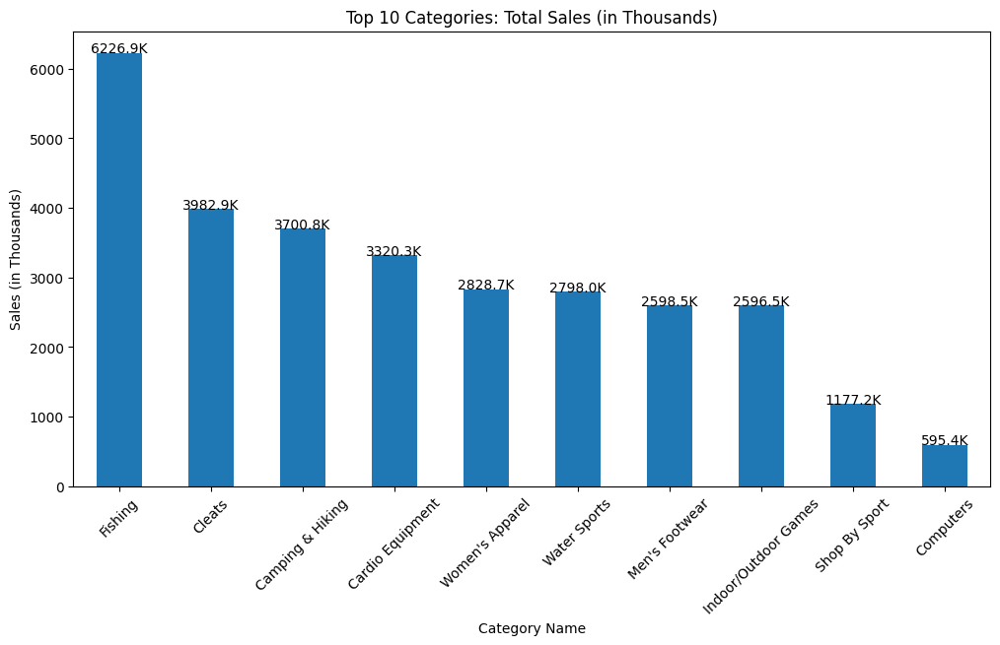

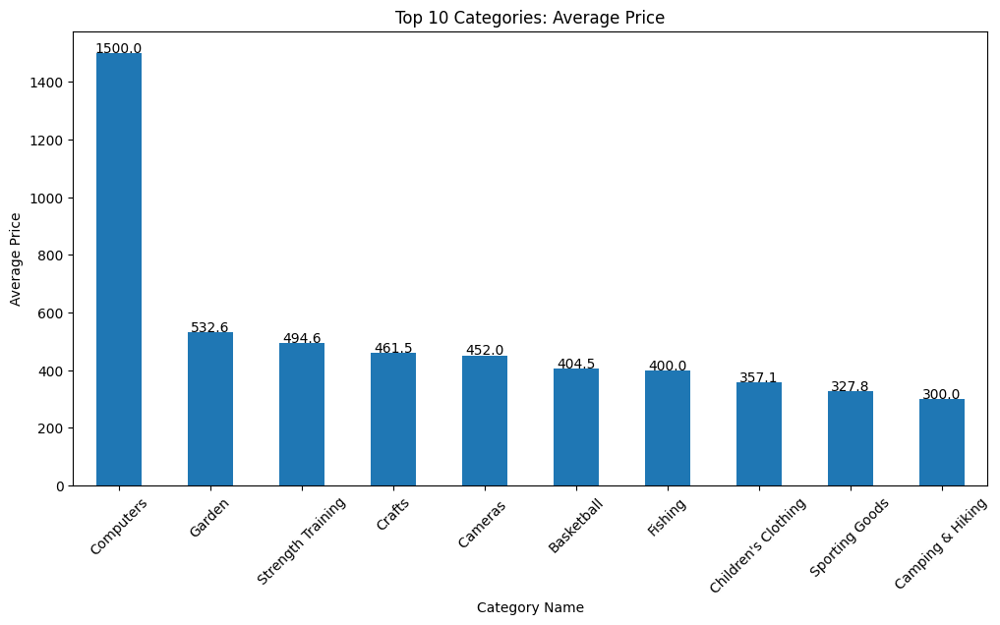

In [26]:
# Grouping by category
cat = data.groupby('Category Name')

# Convert sales to thousands
cat_sales_total = cat['Sales per customer'].sum().sort_values(ascending=False).head(10) / 1000  # Convert to thousands
cat_sales_mean = cat['Sales per customer'].mean().sort_values(ascending=False).head(10)
cat_price_mean = cat['Product Price'].mean().sort_values(ascending=False).head(10)

# Total sum of sales for top 10 categories
plt.figure(figsize=(12,6))
ax1 = cat_sales_total.plot(kind='bar', title="Top 10 Categories: Total Sales (in Thousands)")
plt.ylabel("Sales (in Thousands)")

# Adding smaller data labels
for i, v in enumerate(cat_sales_total):
    ax1.text(i, v + 1, f"{v:.1f}K", ha='center', fontsize=10)

plt.xticks(rotation=45)
plt.show()


# Mean prices for top 10 categories
plt.figure(figsize=(12,6))
ax3 = cat_price_mean.plot(kind='bar', title="Top 10 Categories: Average Price")
plt.ylabel("Average Price")

# Adding smaller data labels
for i, v in enumerate(cat_price_mean):
    ax3.text(i, v + 1, f"{v:.1f}", ha='center', fontsize=10)

plt.xticks(rotation=45)
plt.show()


Fishing and Cleats are among the top 10 categories for top sales, even though only fishing that is included in the top 10 categories for Average Price. As for Computers that has the highest average price, they are placed in the 10th product with the highest sales.

## 3.4 Time related analysis

In [27]:
#extract year, month, week_dat, hour, and month_year from order date
data['order_year']= pd.DatetimeIndex(data['order date (DateOrders)']).year
data['order_month'] = pd.DatetimeIndex(data['order date (DateOrders)']).month
data['order_week_day'] = pd.DatetimeIndex(data['order date (DateOrders)']).weekday
data['order_hour'] = pd.DatetimeIndex(data['order date (DateOrders)']).hour
data['order_month_year'] = pd.to_datetime(data['order date (DateOrders)']).dt.to_period('M')

/tmp/ipykernel_10593/562513200.py:3: FutureWarning: Resampling with a PeriodIndex is deprecated. Cast index to DatetimeIndex before resampling instead.
  quartersales = quarter['Sales'].sum().resample('Q').mean() / 1000  # Convert to thousands


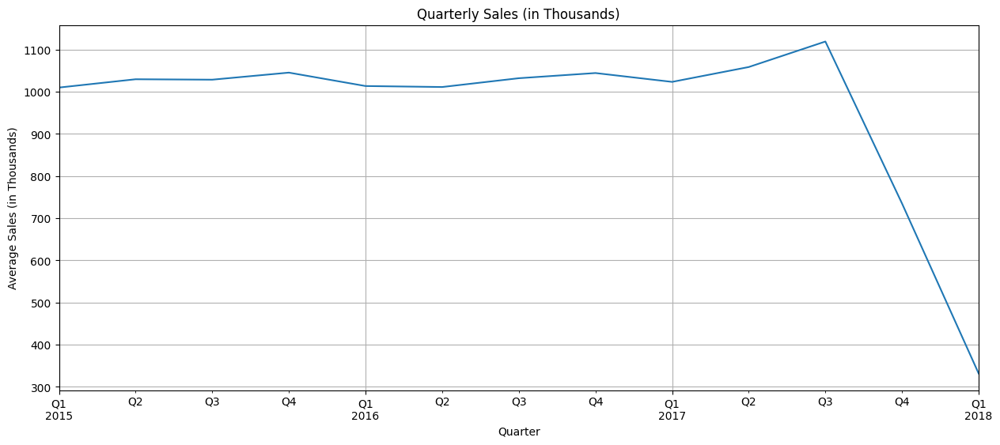

In [28]:
# Group by month and sum sales
quarter = data.groupby('order_month_year')
quartersales = quarter['Sales'].sum().resample('Q').mean() / 1000  # Convert to thousands

# Plot the data
plt.figure(figsize=(15, 6))
quartersales.plot(title="Quarterly Sales (in Thousands)")

# Add labels
plt.xlabel("Quarter")
plt.ylabel("Average Sales (in Thousands)")
plt.grid(True)
plt.show()


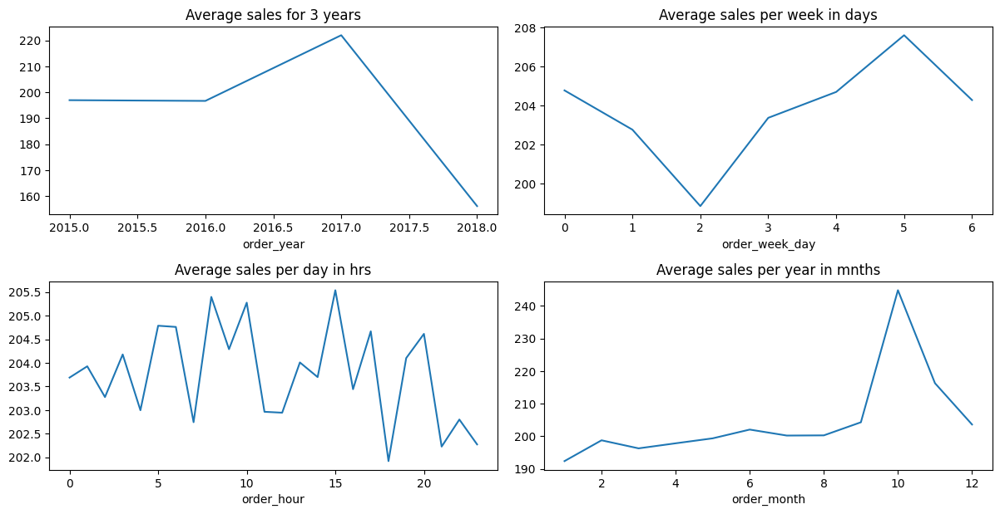

In [29]:
# Plot time series data
plt.figure(figsize=(10,12))
plt.subplot(4, 2, 1)

#quarterly
quater= data.groupby('order_year')
quater['Sales'].mean().plot(figsize=(12,12),title='Average sales for 3 years')
plt.subplot(4, 2, 2)

#daily in a week
days=data.groupby("order_week_day")
days['Sales'].mean().plot(figsize=(12,12),title='Average sales per week in days')
plt.subplot(4, 2, 3)

#hourly in a day
hrs=data.groupby("order_hour")
hrs['Sales'].mean().plot(figsize=(12,12),title='Average sales per day in hrs')
plt.subplot(4, 2, 4)

#monthly
mnth=data.groupby("order_month")
mnth['Sales'].mean().plot(figsize=(12,12),title='Average sales per year in mnths')
plt.tight_layout()
plt.show()

Overall, the sales fluctuates within the period of dataset, before it rises at the start of 2017 eventually decreased after Q3 2017. However, if we inspect it within a more detailed period, we can see a certain pattern. In a weekly basis, Tuesday has the lowest amount of sales. The number rises throughout the week until it peaks at Friday, and decreases again until Tuesday. In hourly basis, the sales fluctuates dynamically. The lowest is in around 18 hour where people might commute at that time, and the highest peak is at 15 where people usually have afternoon breaks. In monthly basis, the sales peaks October. This makes sense because most of the big holidays are coming after October such as Halloween, Christmas, and New Year.

## 3.5 Payment Type Analysis

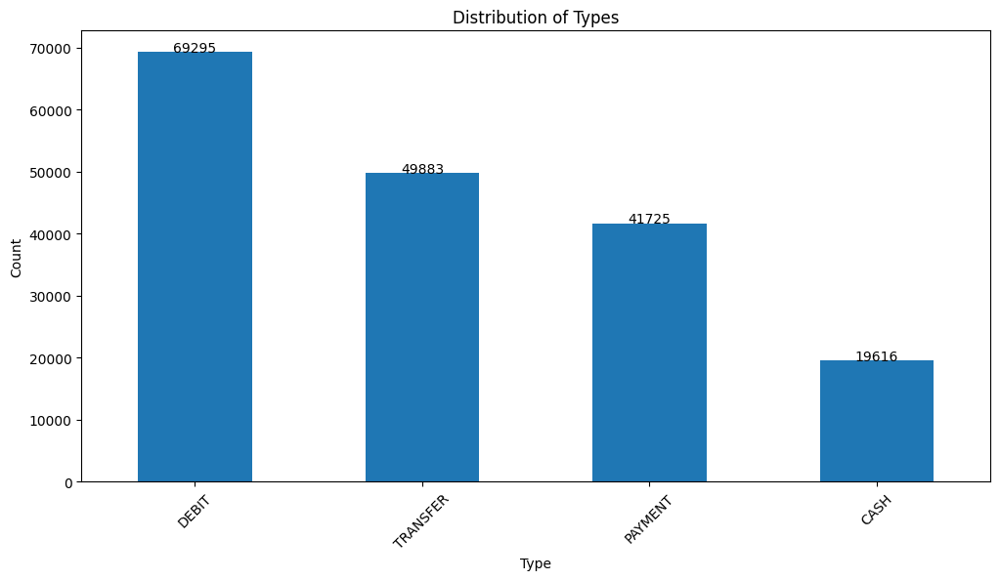

In [30]:
# Count occurrences of each unique value in 'Type' column
type_counts = data['Type'].value_counts()

# Plot bar chart
plt.figure(figsize=(12,6))
ax = type_counts.plot(kind='bar', title="Distribution of Types")
plt.ylabel("Count")
plt.xlabel("Type")

# Adding data labels
for i, v in enumerate(type_counts):
    ax.text(i, v + 1, f"{v}", ha='center', fontsize=10)

plt.xticks(rotation=45)
plt.show()


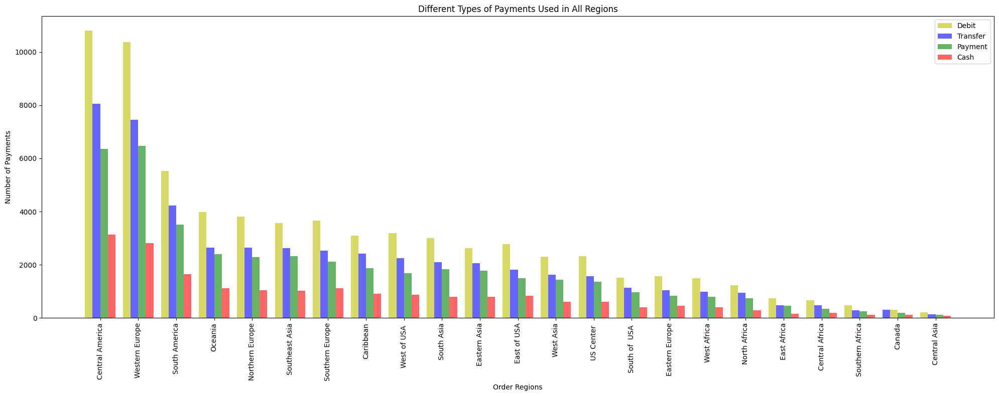

In [31]:
# Plot payment methods data
# Grouping data by 'Type'
xyz1 = data[data['Type'] == 'TRANSFER']
xyz2 = data[data['Type'] == 'CASH']
xyz3 = data[data['Type'] == 'PAYMENT']
xyz4 = data[data['Type'] == 'DEBIT']

# Counting occurrences of 'Order Region' for each payment type
count1 = xyz1['Order Region'].value_counts()
count2 = xyz2['Order Region'].value_counts()
count3 = xyz3['Order Region'].value_counts()
count4 = xyz4['Order Region'].value_counts()

# Getting all unique order regions and sorting them based on total transactions
all_counts = count1.add(count2, fill_value=0).add(count3, fill_value=0).add(count4, fill_value=0)
sorted_regions = all_counts.sort_values(ascending=False).index  # Sorting order regions

# Creating a DataFrame for easy sorting of payment types within each region
payment_df = (
    pd.DataFrame({'Transfer': count1, 'Cash': count2, 'Payment': count3, 'Debit': count4})
    .fillna(0)
    .astype(int)
    .loc[sorted_regions]  # Ensure regions are in sorted order
)

# Sorting payment types within each region from highest to lowest
sorted_payment_types = payment_df.apply(lambda x: x.sort_values(ascending=False).index.tolist(), axis=1)

# Rearranging the data in the sorted order
payment_data_sorted = np.array([payment_df.loc[region, sorted_payment_types.loc[region]] for region in sorted_regions])

# Plotting parameters
n_groups = len(sorted_regions)
fig, ax = plt.subplots(figsize=(20, 8))
index = np.arange(n_groups)
bar_width = 0.2
opacity = 0.6

# Defining colors for each type (ensuring consistent order)
colors = {'Transfer': 'b', 'Cash': 'r', 'Payment': 'g', 'Debit': 'y'}

# Plot bars dynamically based on sorted order
for i, region in enumerate(sorted_regions):
    sorted_types = sorted_payment_types.loc[region]
    for j, payment_type in enumerate(sorted_types):
        plt.bar(index[i] + j * bar_width, payment_df.loc[region, payment_type], bar_width, 
                alpha=opacity, color=colors[payment_type], label=payment_type if i == 0 else "")

# Labels and title
plt.xlabel('Order Regions')
plt.ylabel('Number of Payments')
plt.title('Different Types of Payments Used in All Regions')
plt.legend()

# Updating x-ticks
plt.xticks(index + 1.5 * bar_width, sorted_regions, rotation=90)

plt.tight_layout()
plt.show()


The bar chart shows the amount of each type of payment method. Debit is the most used method whereas cash is the least used one. The ranks are consistent across regions.

## 3.6 Benefit & Loss Analysis

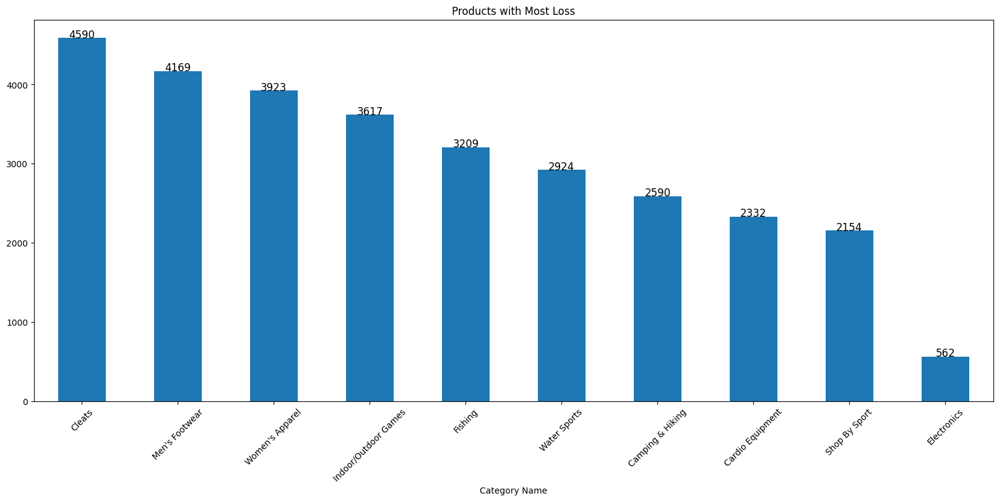

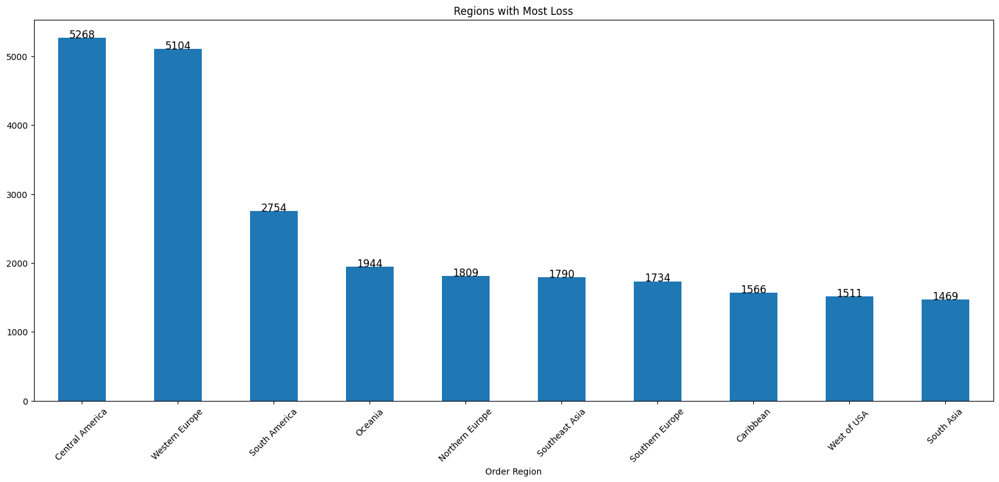

Total revenue lost with orders: -3883547.345768667


In [32]:
# Filter out the loss data
loss = data[data['Benefit per order'] < 0]

# Plot top 10 products with most loss
plt.figure(figsize=(20,8))
ax1 = loss['Category Name'].value_counts().nlargest(10).plot(kind='bar', title="Products with Most Loss")

# Adding data labels
for i, v in enumerate(loss['Category Name'].value_counts().nlargest(10)):
    ax1.text(i, v + 0.5, str(v), ha='center', fontsize=12)

plt.xticks(rotation=45)
plt.show()

# Plot top 10 regions with most loss
plt.figure(figsize=(20,8))
ax2 = loss['Order Region'].value_counts().nlargest(10).plot(kind='bar', title="Regions with Most Loss")

# Adding data labels
for i, v in enumerate(loss['Order Region'].value_counts().nlargest(10)):
    ax2.text(i, v + 0.5, str(v), ha='center', fontsize=12)

plt.xticks(rotation=45)
plt.show()

# Sum of total sales that are lost
print('Total revenue lost with orders:', loss['Benefit per order'].sum())


Based on the bargraphs above, we can see that Cleats, Men's Footwear, and Women's Apparel have the most loss. This can happen because these items usually have return policy, increasing the chance of loss. Competition can also play a part, and it forces sellers to reduce the price, increasing the chance of loss. The most loss happens in Central America region.

## 3.7 Suspected Frauds Analysis

In [33]:
#Checking type of payment used to conduct fraud
xyz = data[(data['Order Status'] == 'SUSPECTED_FRAUD')]
xyz['Type'].value_counts()

Type
TRANSFER    4062
Name: count, dtype: int64

In [34]:
data['Order Status'].value_counts()

Order Status
COMPLETE           59491
PENDING_PAYMENT    39832
PROCESSING         21902
PENDING            20227
CLOSED             19616
ON_HOLD             9804
SUSPECTED_FRAUD     4062
CANCELED            3692
PAYMENT_REVIEW      1893
Name: count, dtype: int64

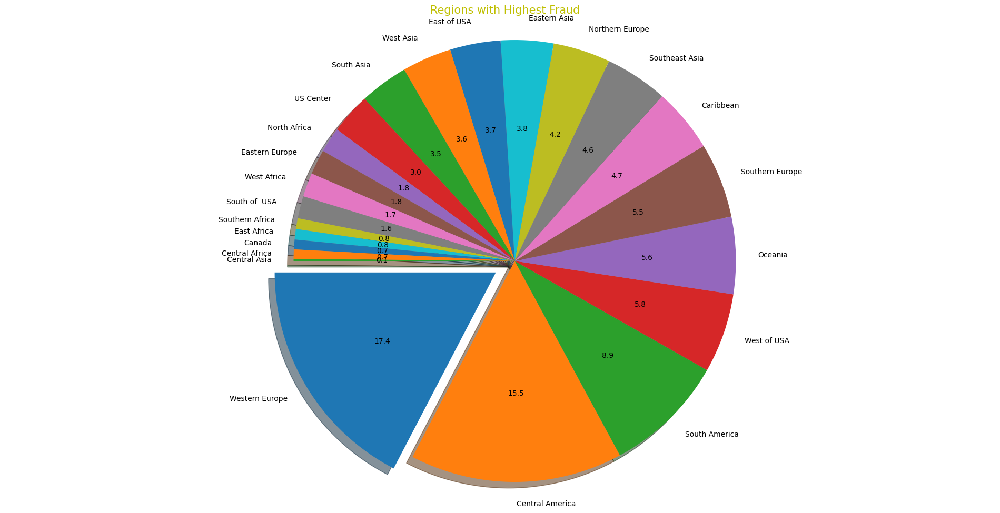

In [35]:
#separating orders with suspected fraud
high_fraud = data[(data['Order Status'] == 'SUSPECTED_FRAUD') & (data['Type'] == 'TRANSFER')]

#Plotting pie chart with respect to order region
fraud=high_fraud['Order Region'].value_counts().plot.pie(figsize=(24,12),
                                                  startangle=180, explode=(0.1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0),autopct='%.1f',shadow=True,)
plt.title("Regions with Highest Fraud",size=15,color='y') # Plotting title
plt.ylabel(" ")
fraud.axis('equal') 
plt.show()

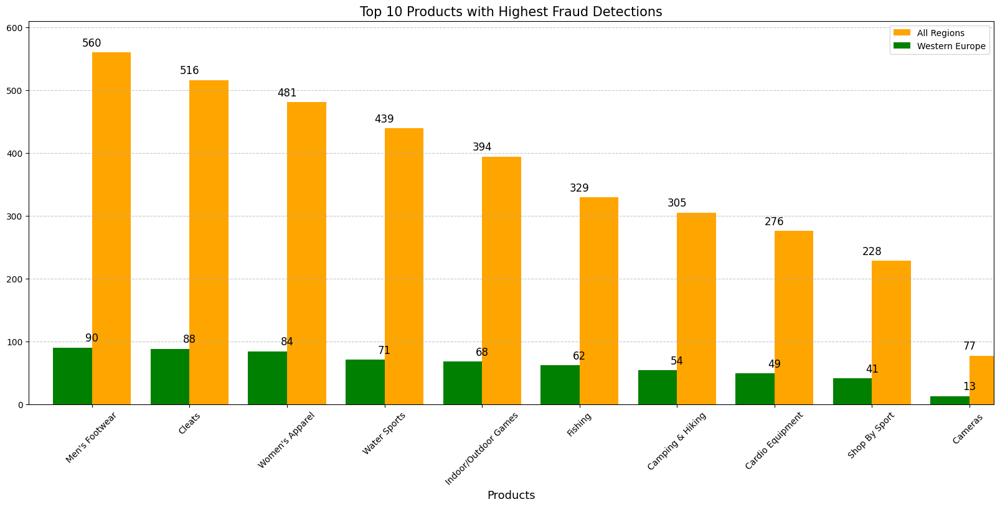

In [36]:
# Filter suspected fraud cases
high_fraud1 = data[data['Order Status'] == 'SUSPECTED_FRAUD']  
high_fraud2 = data[(data['Order Status'] == 'SUSPECTED_FRAUD') & (data['Order Region'] == 'Western Europe')]

# Get top 10 fraud categories for all regions
fraud1_counts = high_fraud1['Category Name'].value_counts().nlargest(10)
fraud2_counts = high_fraud2['Category Name'].value_counts().nlargest(10)

# Create figure and axis
plt.figure(figsize=(20,8))

# Plot bar chart for top 10 fraud categories in all regions
ax1 = fraud1_counts.plot(kind='bar', color='orange', position=0, width=0.4, label="All Regions")

# Plot bar chart for top 10 fraud categories in Western Europe
ax2 = fraud2_counts.plot(kind='bar', color='green', position=1, width=0.4, label="Western Europe")

# Add data labels for all regions
for i, v in enumerate(fraud1_counts):
    ax1.text(i, v + 10, str(v), ha='center', fontsize=12)

# Add data labels for Western Europe
for i, v in enumerate(fraud2_counts):
    ax2.text(i, v + 10, str(v), ha='center', fontsize=12)

# Chart formatting
plt.legend()
plt.title("Top 10 Products with Highest Fraud Detections", size=15)
plt.xlabel("Products", size=13)
plt.ylim(0, max(fraud1_counts.max(), fraud2_counts.max()) + 50)  # Adjust y-limit dynamically
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()


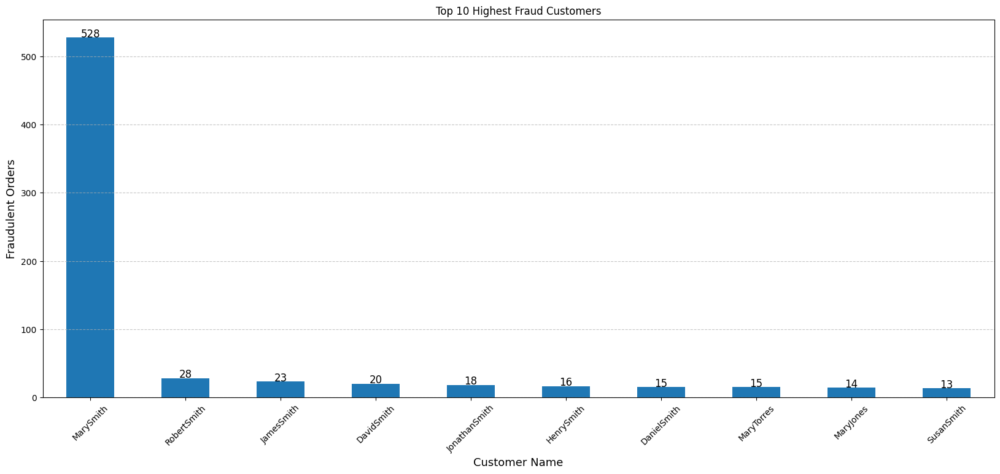

In [37]:
# Filtering suspected fraud orders
cus = data[data['Order Status'] == 'SUSPECTED_FRAUD']

# Get top 10 customers with the most fraud cases
fraud_customers = cus['Customer Full Name'].value_counts().nlargest(10)

# Plot bar chart
plt.figure(figsize=(20,8))
ax = fraud_customers.plot(kind='bar', title="Top 10 Highest Fraud Customers")

# Adding data labels
for i, v in enumerate(fraud_customers):
    ax.text(i, v + 1, str(v), ha='center', fontsize=12)

# Formatting
plt.xlabel("Customer Name", size=13)
plt.ylabel("Fraudulent Orders", size=13)
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.show()


In [38]:
#Filtering orders of mary smith with suspected fraud
amount = data[(data['Customer Full Name'] == 'MarySmith')&(data['Order Status'] == 'SUSPECTED_FRAUD')]

#Plotting bar chart for top 10 most suspected fraud customers
amount['Sales'].sum()

np.float64(102491.66191043999)

Based on the above, of the total Suspected Fraud order of 4062, 17% among them are from Western Europe. Also, top 3 frauds are from Men's Footwear, Cleats, and Women's Apparel. Previously we already discussed risks that can make those 3 products have the highest loss. Turns out those 3 products also have the highest amount of fraud. Additionally, highest fraud customer is named Mary Smith. 

## 3.8 Late Deliveries Analysis

<Axes: title={'center': 'Top 10 products with most late deliveries'}, xlabel='Category Name'>

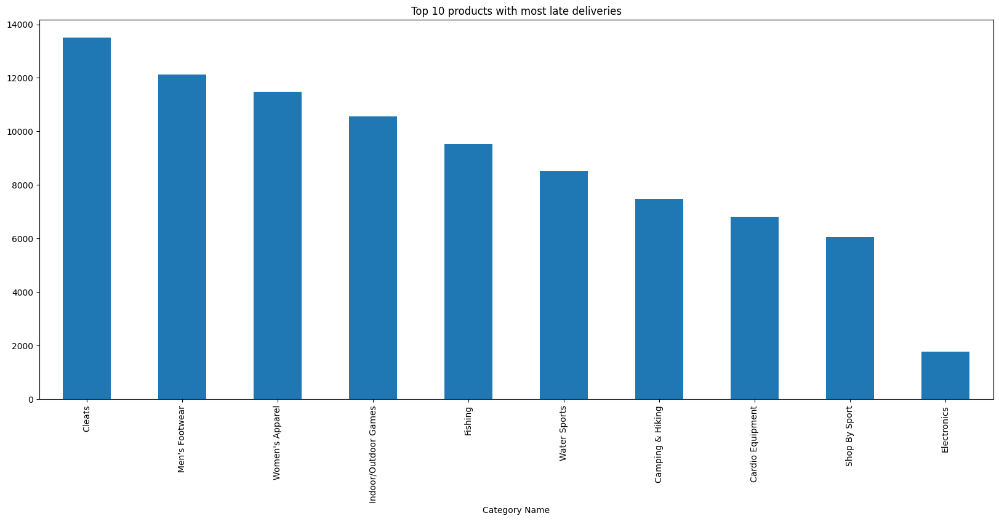

In [39]:
#Filtering columns with late delivery status
late_delivery = data[(data['Delivery Status'] == 'Late delivery')]
#Top 10 products with most late deliveries
late_delivery['Category Name'].value_counts().nlargest(10).plot.bar(figsize=(20,8), title="Top 10 products with most late deliveries")

The bar chart above also adds reasons why Cleats, Men's Footwear and Women's Apparel have the highest loss, and it's because they all have the highest number of late deliveries.

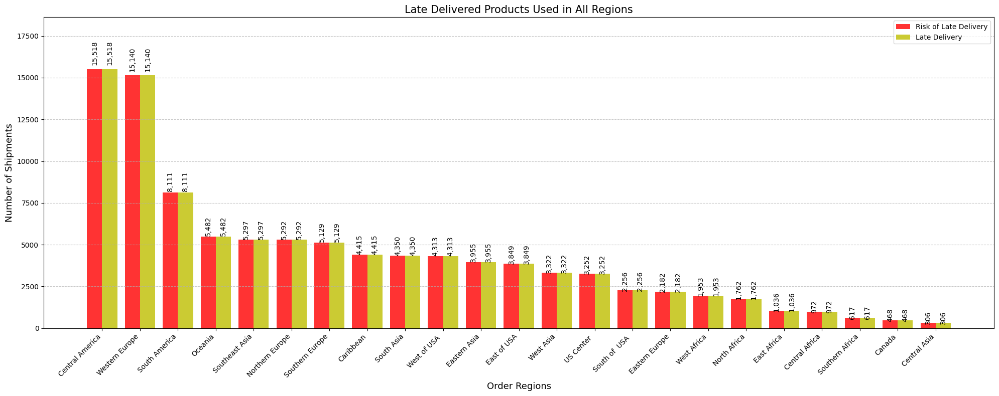

In [40]:
# Filtering orders with late delivery risk
xyz1 = data[data['Late_delivery_risk'] == 1]

# Filtering actual late delivered orders
xyz2 = data[data['Delivery Status'] == 'Late delivery']

# Count occurrences per region
count1 = xyz1['Order Region'].value_counts()
count2 = xyz2['Order Region'].value_counts()

# Get index names
names = count1.index  # Use index from count1 to match available regions
n_groups = len(names)

# Figure setup
fig, ax = plt.subplots(figsize=(20, 8))
index = np.arange(n_groups)
bar_width = 0.4  # Wider spacing to prevent clutter
opacity = 0.8

# Plot bars
type1 = ax.bar(index, count1, bar_width, alpha=opacity, color='r', label='Risk of Late Delivery')
type2 = ax.bar(index + bar_width, count2, bar_width, alpha=opacity, color='y', label='Late Delivery')

# Adding data labels with proper spacing
for i, (v1, v2) in enumerate(zip(count1, count2)):
    ax.text(i, v1 + (v1 * 0.02), f"{v1:,}", ha='center', fontsize=10, rotation=90, color='black')
    ax.text(i + bar_width, v2 + (v2 * 0.02), f"{v2:,}", ha='center', fontsize=10, rotation=90, color='black')

# Formatting
ax.set_xlabel('Order Regions', fontsize=13)
ax.set_ylabel('Number of Shipments', fontsize=13)
ax.set_title('Late Delivered Products Used in All Regions', fontsize=15)
ax.legend()
ax.set_xticks(index + bar_width / 2)
ax.set_xticklabels(names, rotation=45, ha="right")  # Rotate x-axis labels for better readability
ax.set_ylim(0, max(count1.max(), count2.max()) * 1.2)  # Adjust y-axis limit for spacing
ax.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()


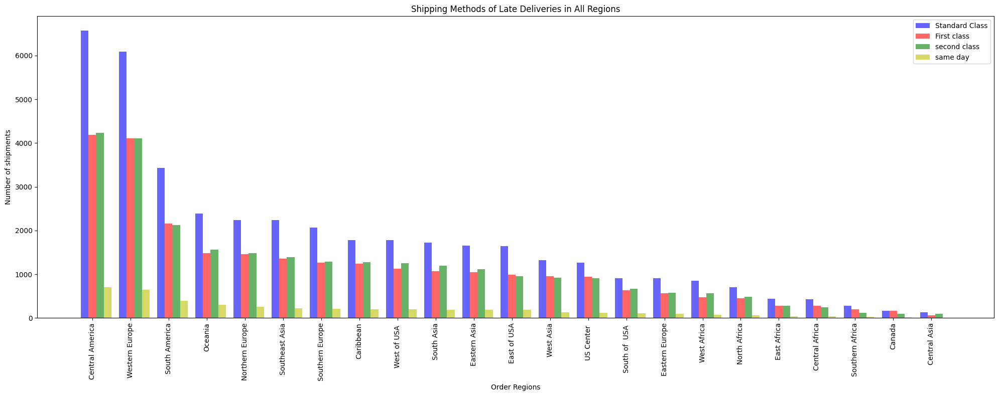

In [41]:
#Filtering late delivery orders with standard class shipping
xyz1 = data[(data['Delivery Status'] == 'Late delivery') & (data['Shipping Mode'] == 'Standard Class')]
#Filtering late delivery orders with first class shipping
xyz2 = data[(data['Delivery Status'] == 'Late delivery') & (data['Shipping Mode'] == 'First Class')]
#Filtering late delivery orders with second class shipping
xyz3 = data[(data['Delivery Status'] == 'Late delivery') & (data['Shipping Mode'] == 'Second Class')]
#Filtering late delivery orders with same day shipping
xyz4 = data[(data['Delivery Status'] == 'Late delivery') & (data['Shipping Mode'] == 'Same Day')]

#Counting total values
count1=xyz1['Order Region'].value_counts()
count2=xyz2['Order Region'].value_counts()
count3=xyz3['Order Region'].value_counts()
count4=xyz4['Order Region'].value_counts()

#Index names
names=data['Order Region'].value_counts().keys()
n_groups=23
fig,ax = plt.subplots(figsize=(20,8))
index=np.arange(n_groups)
bar_width=0.2
opacity=0.6
type1=plt.bar(index,count1,bar_width,alpha=opacity,color='b',label='Standard Class')
type2=plt.bar(index+bar_width,count2,bar_width,alpha=opacity,color='r',label='First class')
type3=plt.bar(index+bar_width+bar_width,count3,bar_width,alpha=opacity,color='g',label='second class')
type4=plt.bar(index+bar_width+bar_width+bar_width,count4,bar_width,alpha=opacity,color='y',label='same day')
plt.xlabel('Order Regions')
plt.ylabel('Number of shipments')
plt.title('Shipping Methods of Late Deliveries in All Regions')
plt.legend()
plt.xticks(index+bar_width,names,rotation=90)
plt.tight_layout()
plt.show()


Based on the bargraph above, we can see that Central America, Western Europe, and South America are regions with the highest number of late deliveries. Standard class have the highest late deliveries accross regions while same day has the lowest, which are not surprising. Surprisingly, first class deliveries has about the same amount of late deliveries as second class.

In [42]:
#Calculating total price for which each order
data['TotalPrice'] = data['Order Item Quantity'] * data['Order Item Total']# Multiplying item price * Order quantity

In [43]:
data['order date (DateOrders)'].max() # Calculating when the last order come to check recency

'9/9/2017 9:50'

In [44]:
#Present date was set to next day of the last order. i.e,2018-02-01
present = dt.datetime(2018,2,1)
data['order date (DateOrders)'] = pd.to_datetime(data['order date (DateOrders)'])

## 3.9 RFM Analysis

In [45]:
# Grouping all values into a new data frame named customer segmentation
Customer_seg = data.groupby('Order Customer Id').agg({
    'order date (DateOrders)': lambda x: (present - x.max()).days,  # Recency (higher is worse)
    'Order Id': lambda x: len(x),  # Frequency (higher is better)
    'TotalPrice': lambda x: x.sum()  # Monetary (higher is better)
})

# Convert order dates to int format
Customer_seg['order date (DateOrders)'] = Customer_seg['order date (DateOrders)'].astype(int)

# **Reverse Recency Score**
Customer_seg['Reversed_R_Value'] = Customer_seg['order date (DateOrders)'].max() - Customer_seg['order date (DateOrders)']

# Renaming columns
Customer_seg.rename(columns={
    'Reversed_R_Value': 'R_Value',  # Now, higher is better
    'Order Id': 'F_Value',
    'TotalPrice': 'M_Value'
}, inplace=True)

# Drop the original recency column
Customer_seg.drop(columns=['order date (DateOrders)'], inplace=True)

# Display updated segmentation
Customer_seg.head()


,F_Value,M_Value,R_Value
Order Customer Id,,,
1,1,2362.250061,333
2,10,2842.700073,989
3,18,6143.760057,896
4,14,4370.629991,745
5,7,2993.790032,668


/tmp/ipykernel_10593/2182839548.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Customer_seg['R_Value'])# Plot distribution of R_Value
/tmp/ipykernel_10593/2182839548.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(Customer_seg['F_Value'])# Plot distribution of F_Value
/tmp/ipykernel_105

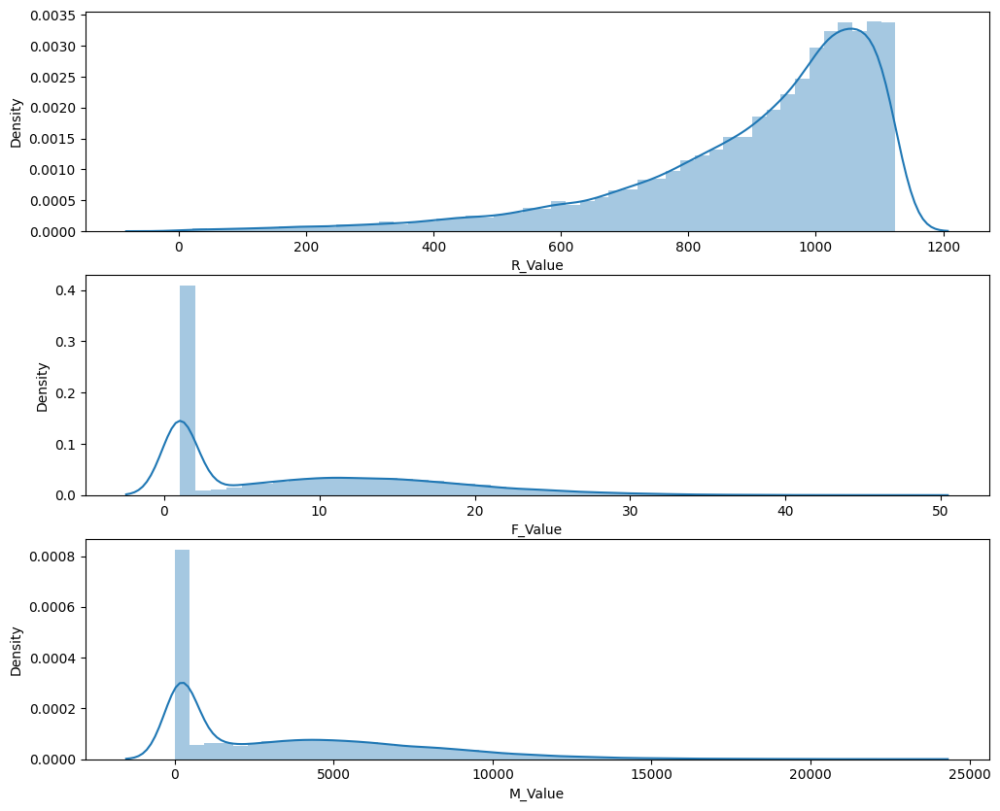

In [46]:
#Plot RFM data distribution
plt.figure(figsize=(12,10)) # Figure size
plt.subplot(3, 1, 1)
sns.distplot(Customer_seg['R_Value'])# Plot distribution of R_Value
plt.subplot(3, 1, 2) 
sns.distplot(Customer_seg['F_Value'])# Plot distribution of F_Value
plt.subplot(3, 1, 3)
sns.distplot(Customer_seg['M_Value'])# Plot distribution of M_Value
plt.show()

RFM analysis is a common variable analysis in a marketplace. As we can see, the data are skewed across those three variables. We will transform the data into new score based on the quantile.

In [47]:
quantiles = Customer_seg.quantile(q=[0.25,0.5,0.75]) #Dividing RFM data into four quartiles
quantiles = quantiles.to_dict() 

In [48]:
# R_Score should be minimum so 1st quantile is set as 1.
def R_Score(a,b,c):
    if a <= c[b][0.25]:
        return 1
    elif a <= c[b][0.50]:
        return 2
    elif a <= c[b][0.75]: 
        return 3
    else:
        return 4
# The higher the F_Score,M_Score the better so 1st quantile is set as 4.    
def FM_Score(x,y,z):
    if x <= z[y][0.25]:
        return 4
    elif x <= z[y][0.50]:
        return 3
    elif x <= z[y][0.75]: 
        return 2
    else:
        return 1

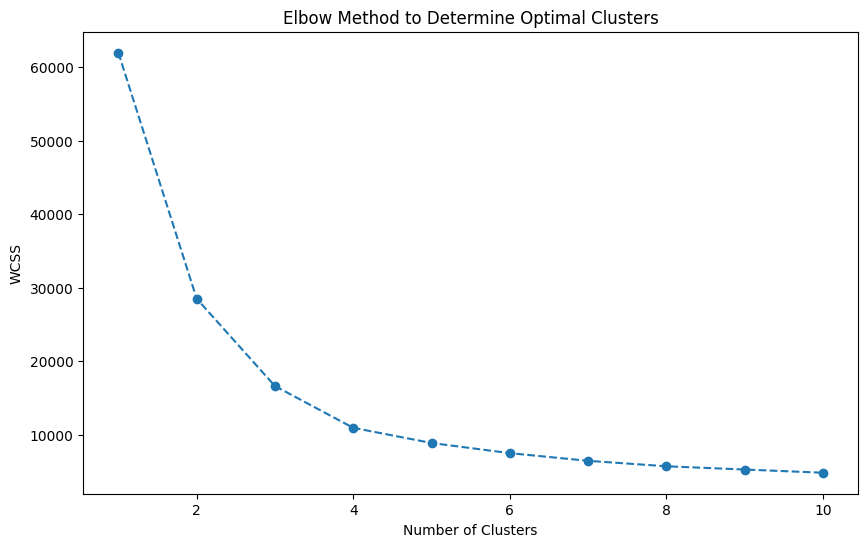

In [49]:
# Assuming `Customer_seg` has 'Recency', 'Frequency', and 'Monetary' columns
rfm_data = Customer_seg[['R_Value', 'F_Value', 'M_Value']]

# Standardize the data
scaler = StandardScaler()
rfm_scaled = scaler.fit_transform(rfm_data)

# Determine the optimal number of clusters using the Elbow Method
wcss = []  # Within-cluster sum of squares
for i in range(1, 11):  # Trying k from 1 to 10
    kmeans = KMeans(n_clusters=i, init='k-means++', max_iter=300, n_init=10, random_state=42)
    kmeans.fit(rfm_scaled)
    wcss.append(kmeans.inertia_)

# Plot Elbow Method
plt.figure(figsize=(10, 6))
plt.plot(range(1, 11), wcss, marker='o', linestyle='--')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.title('Elbow Method to Determine Optimal Clusters')
plt.show()



         R_Value  F_Value  M_Value
Cluster                           
0         476.67     7.77  3092.80
1        1056.18     1.20   337.84
2         878.01    22.50  9893.94
3         862.50    12.20  4820.15


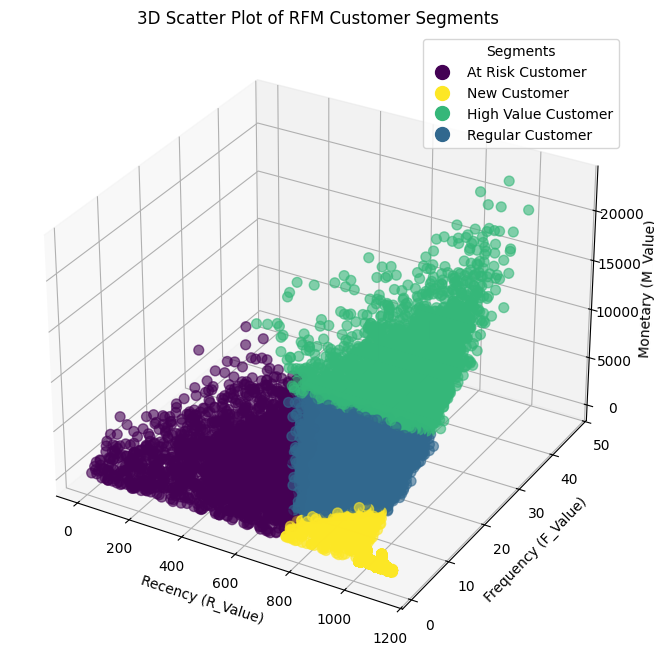

In [50]:
# Choose optimal k based on the Elbow method (e.g., k=4)
optimal_k = 4
kmeans = KMeans(n_clusters=optimal_k, init='k-means++', max_iter=300, n_init=10, random_state=42)
Customer_seg['Cluster'] = kmeans.fit_predict(rfm_scaled)

# Analyzing the clusters
cluster_summary = Customer_seg.groupby('Cluster').agg({
    'R_Value': 'mean',
    'F_Value': 'mean',
    'M_Value': 'mean'
}).round(2)

# Assign meaningful labels based on cluster properties
cluster_labels = {
    0: 'At Risk Customer',
    1: 'New Customer',
    2: 'High Value Customer',
    3: 'Regular Customer'
}

Customer_seg['Customer_Segmentation'] = Customer_seg['Cluster'].map(cluster_labels)

# Print cluster summary
print(cluster_summary)

# Create a color map based on cluster assignments
colors = plt.cm.viridis(np.linspace(0, 1, optimal_k))
color_dict = {cluster: colors[i] for i, cluster in enumerate(Customer_seg['Cluster'].unique())}

# Creating 3D scatter plot
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot with correct color mapping
scatter = ax.scatter(
    Customer_seg['R_Value'], 
    Customer_seg['F_Value'], 
    Customer_seg['M_Value'], 
    c=Customer_seg['Cluster'].map(color_dict), s=50, alpha=0.6
)

# Axis labels and title
ax.set_xlabel('Recency (R_Value)')
ax.set_ylabel('Frequency (F_Value)')
ax.set_zlabel('Monetary (M_Value)')
ax.set_title('3D Scatter Plot of RFM Customer Segments')

# Create legend with correctly mapped colors
legend_labels = [plt.Line2D([0], [0], marker='o', color=color_dict[cluster], markersize=10, linestyle='None') 
                 for cluster in cluster_labels.keys()]
ax.legend(legend_labels, cluster_labels.values(), loc='upper right', title="Segments")

# Show plot
plt.show()


In [51]:
# Creating interactive 3D scatter plot with Plotly
fig = px.scatter_3d(
    Customer_seg, 
    x='R_Value', 
    y='F_Value', 
    z='M_Value', 
    color='Customer_Segmentation', 
    title='Interactive 3D Scatter Plot of RFM Customer Segments',
    labels={'R_Value': 'Recency', 'F_Value': 'Frequency', 'M_Value': 'Monetary'},
    opacity=0.7,
    hover_data=['Customer_Segmentation']
)

# Show interactive plot
fig.show()


In [52]:
Customer_seg['Customer_Segmentation'].value_counts()

Customer_Segmentation
New Customer           8837
Regular Customer       6020
High Value Customer    3488
At Risk Customer       2307
Name: count, dtype: int64

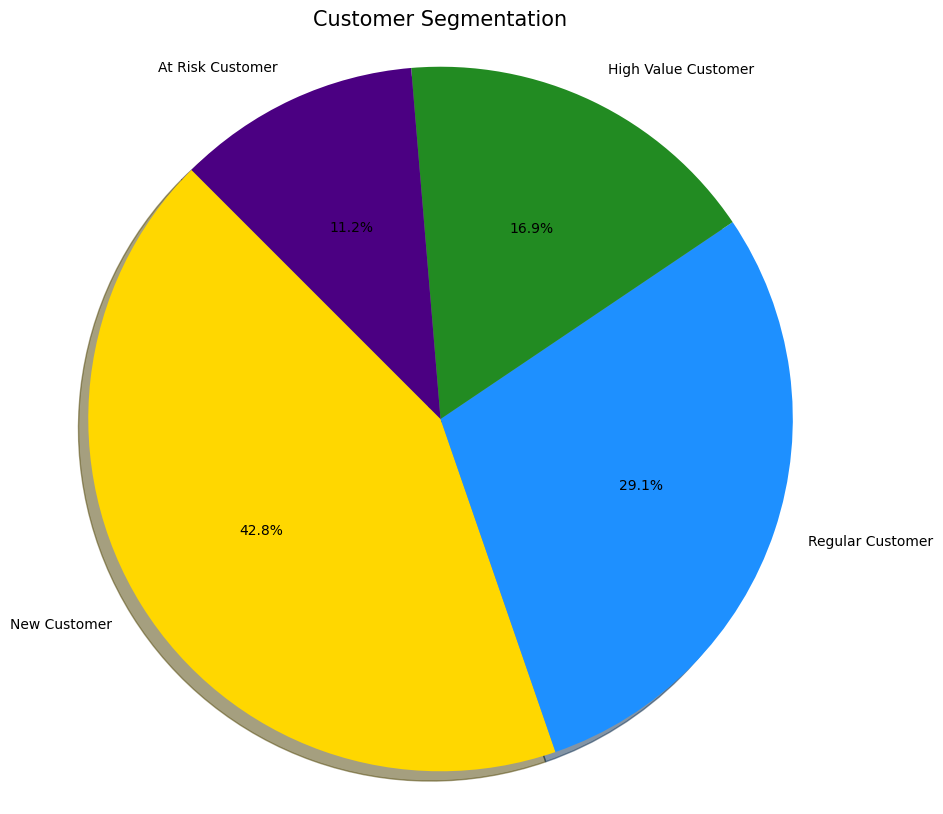

In [53]:
# Define color mapping based on scatter plot
scatter_colors = {
    'At Risk Customer': '#4B0082',  # Dark Purple
    'New Customer': '#FFD700',  # Yellow
    'High Value Customer': '#228B22',  # Green
    'Regular Customer': '#1E90FF'  # Blue
}

# Create the pie chart with matching colors
Customer_seg['Customer_Segmentation'].value_counts().plot.pie(
    figsize=(10,10),
    startangle=135,
    autopct='%.1f%%',
    shadow=True,
    colors=[scatter_colors[label] for label in Customer_seg['Customer_Segmentation'].value_counts().index]
)

plt.title("Customer Segmentation", size=15)
plt.ylabel(" ")
plt.axis('equal')  # Ensures a perfect circle
plt.show()


We will cluster the customers based on the RFM to summary their customer value. Based on the elbow method, we can get 4 cluster. Based on the scatterplot visualization and the RFM score summary, we can define the clusters as At Risk Customer, High Value Customer, New Customer, and Regular Customer. At risk customer has low recency score, which might imply they are churning. We can prevent it by using discounts. New customer has high recency score, low frequency, and low monetary value, which might imply that they are recent customers and can have potential. Promotions and discounts can also increase their value. High value customer has about high score on those three variables, while regular customer has about average score on those three variables. Diversification can help high value customers to keep buying more, while regular customer, although can benefit from interventions like promotions and discounts, might be the last priority. We can further deepen the enalaysis in each cluster.

In [54]:
# Filter only 'High Value Customer' and sort by Recency (R_Value) and Monetary (M_Value)
churned = Customer_seg[
    Customer_seg['Customer_Segmentation'] == 'High Value Customer'
].sort_values(by=['R_Value', 'M_Value'], ascending=[True, False]).head(10)

# Display top 10 churned customers
churned


,F_Value,M_Value,R_Value,Cluster,Customer_Segmentation
Order Customer Id,,,,,
3197,22,11031.420056,327,2,High Value Customer
11516,31,12536.050133,352,2,High Value Customer
8697,27,12488.140110,373,2,High Value Customer
4795,21,11753.069988,384,2,High Value Customer
10721,22,11446.260025,414,2,High Value Customer
3980,21,12112.870041,421,2,High Value Customer
1373,23,14727.120053,439,2,High Value Customer
9496,26,9632.810108,450,2,High Value Customer
9924,22,8604.820114,454,2,High Value Customer


Above are high value customers who have high monetary value yet low recency score. We should definitely target this as a priority since they have high monetary value.

In [55]:
# Filter only 'High Value Customer' and sort by Recency (R_Value) and Monetary (M_Value)
churned = Customer_seg[
    Customer_seg['Customer_Segmentation'] == 'High Value Customer'
].sort_values(by=['F_Value', 'M_Value'], ascending=[False, False]).head(10)

# Display top 10 churned customers
churned


,F_Value,M_Value,R_Value,Cluster,Customer_Segmentation
Order Customer Id,,,,,
5654,47,19653.650249,1003,2,High Value Customer
5004,45,22779.770180,953,2,High Value Customer
10591,45,17192.900127,877,2,High Value Customer
5715,44,20418.460204,939,2,High Value Customer
9371,44,16487.250028,978,2,High Value Customer
3708,44,13983.880149,974,2,High Value Customer
12284,43,20689.189920,904,2,High Value Customer
791,43,18640.880013,998,2,High Value Customer
2641,43,18357.610185,948,2,High Value Customer


Above are high value customers who have high monetary value yet low recency score. We should definitely target this as a second priority since they already have high frequency and recency, where we can have some intervention to make them spend more.

## 3.10 Feature Engineering

In [56]:
Customer_seg.reset_index(inplace=True)
Customer_seg

,Order Customer Id,F_Value,M_Value,R_Value,Cluster,Customer_Segmentation
0,1,1,2362.250061,333,0,At Risk Customer
1,2,10,2842.700073,989,3,Regular Customer
2,3,18,6143.760057,896,3,Regular Customer
3,4,14,4370.629991,745,3,Regular Customer
4,5,7,2993.790032,668,0,At Risk Customer
...,...,...,...,...,...,...
20647,20753,1,161.869995,1125,1,New Customer
20648,20754,1,172.660004,1125,1,New Customer
20649,20755,1,314.640015,1125,1,New Customer
20650,20756,1,10.910000,1125,1,New Customer


In [57]:
data.head(5)

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Id,Customer Segment,Customer State,Customer Zipcode,Department Id,Department Name,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Product Card Id,Product Category Id,Product Name,Product Price,Shipping Mode,Customer Full Name,order_year,order_month,order_week_day,order_hour,order_month_year,TotalPrice
0,DEBIT,3,4,91.250000,314.640015,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,20755,Consumer,PR,725.0,2,Fitness,Pacific Asia,Bekasi,Indonesia,20755,2018-01-31 22:56:00,77202,1360,13.110000,0.04,180517,327.75,0.29,1,327.75,314.640015,91.250000,Southeast Asia,Java Occidental,COMPLETE,1360,73,Smart watch,327.75,Standard Class,CallyHolloway,2018,1,2,22,2018-01,314.640015
1,TRANSFER,5,4,-249.089996,311.359985,Late delivery,1,73,Sporting Goods,Caguas,Puerto Rico,19492,Consumer,PR,725.0,2,Fitness,Pacific Asia,Bikaner,India,19492,2018-01-13 12:27:00,75939,1360,16.389999,0.05,179254,327.75,-0.80,1,327.75,311.359985,-249.089996,South Asia,Rajastán,PENDING,1360,73,Smart watch,327.75,Standard Class,IreneLuna,2018,1,5,12,2018-01,311.359985
2,CASH,4,4,-247.779999,309.720001,Shipping on time,0,73,Sporting Goods,San Jose,EE. UU.,19491,Consumer,CA,95125.0,2,Fitness,Pacific Asia,Bikaner,India,19491,2018-01-13 12:06:00,75938,1360,18.030001,0.06,179253,327.75,-0.80,1,327.75,309.720001,-247.779999,South Asia,Rajastán,CLOSED,1360,73,Smart watch,327.75,Standard Class,GillianMaldonado,2018,1,5,12,2018-01,309.720001
3,DEBIT,3,4,22.860001,304.809998,Advance shipping,0,73,Sporting Goods,Los Angeles,EE. UU.,19490,Home Office,CA,90027.0,2,Fitness,Pacific Asia,Townsville,Australia,19490,2018-01-13 11:45:00,75937,1360,22.940001,0.07,179252,327.75,0.08,1,327.75,304.809998,22.860001,Oceania,Queensland,COMPLETE,1360,73,Smart watch,327.75,Standard Class,TanaTate,2018,1,5,11,2018-01,304.809998
4,PAYMENT,2,4,134.210007,298.250000,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,19489,Corporate,PR,725.0,2,Fitness,Pacific Asia,Townsville,Australia,19489,2018-01-13 11:24:00,75936,1360,29.500000,0.09,179251,327.75,0.45,1,327.75,298.250000,134.210007,Oceania,Queensland,PENDING_PAYMENT,1360,73,Smart watch,327.75,Standard Class,OrliHendricks,2018,1,5,11,2018-01,298.250000


In [58]:
# Merge customer segmentation result to main_df
df_merged = pd.merge(
    data,
    Customer_seg[['Order Customer Id', 'Customer_Segmentation']],
    on='Order Customer Id',
    how='left'
)

df_merged.head(5)

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Id,Customer Segment,Customer State,Customer Zipcode,Department Id,Department Name,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Product Card Id,Product Category Id,Product Name,Product Price,Shipping Mode,Customer Full Name,order_year,order_month,order_week_day,order_hour,order_month_year,TotalPrice,Customer_Segmentation
0,DEBIT,3,4,91.250000,314.640015,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,20755,Consumer,PR,725.0,2,Fitness,Pacific Asia,Bekasi,Indonesia,20755,2018-01-31 22:56:00,77202,1360,13.110000,0.04,180517,327.75,0.29,1,327.75,314.640015,91.250000,Southeast Asia,Java Occidental,COMPLETE,1360,73,Smart watch,327.75,Standard Class,CallyHolloway,2018,1,2,22,2018-01,314.640015,New Customer
1,TRANSFER,5,4,-249.089996,311.359985,Late delivery,1,73,Sporting Goods,Caguas,Puerto Rico,19492,Consumer,PR,725.0,2,Fitness,Pacific Asia,Bikaner,India,19492,2018-01-13 12:27:00,75939,1360,16.389999,0.05,179254,327.75,-0.80,1,327.75,311.359985,-249.089996,South Asia,Rajastán,PENDING,1360,73,Smart watch,327.75,Standard Class,IreneLuna,2018,1,5,12,2018-01,311.359985,New Customer
2,CASH,4,4,-247.779999,309.720001,Shipping on time,0,73,Sporting Goods,San Jose,EE. UU.,19491,Consumer,CA,95125.0,2,Fitness,Pacific Asia,Bikaner,India,19491,2018-01-13 12:06:00,75938,1360,18.030001,0.06,179253,327.75,-0.80,1,327.75,309.720001,-247.779999,South Asia,Rajastán,CLOSED,1360,73,Smart watch,327.75,Standard Class,GillianMaldonado,2018,1,5,12,2018-01,309.720001,New Customer
3,DEBIT,3,4,22.860001,304.809998,Advance shipping,0,73,Sporting Goods,Los Angeles,EE. UU.,19490,Home Office,CA,90027.0,2,Fitness,Pacific Asia,Townsville,Australia,19490,2018-01-13 11:45:00,75937,1360,22.940001,0.07,179252,327.75,0.08,1,327.75,304.809998,22.860001,Oceania,Queensland,COMPLETE,1360,73,Smart watch,327.75,Standard Class,TanaTate,2018,1,5,11,2018-01,304.809998,New Customer
4,PAYMENT,2,4,134.210007,298.250000,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,19489,Corporate,PR,725.0,2,Fitness,Pacific Asia,Townsville,Australia,19489,2018-01-13 11:24:00,75936,1360,29.500000,0.09,179251,327.75,0.45,1,327.75,298.250000,134.210007,Oceania,Queensland,PENDING_PAYMENT,1360,73,Smart watch,327.75,Standard Class,OrliHendricks,2018,1,5,11,2018-01,298.250000,New Customer


In [59]:
# summarize fraud and late delivery information into binary columns
df_merged['fraud'] = np.where(df_merged['Order Status'] == 'SUSPECTED_FRAUD', 1, 0)
df_merged['late_delivery']=np.where(df_merged['Delivery Status'] == 'Late delivery', 1, 0)
df_merged.head(5)

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Id,Customer Segment,Customer State,Customer Zipcode,Department Id,Department Name,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Product Card Id,Product Category Id,Product Name,Product Price,Shipping Mode,Customer Full Name,order_year,order_month,order_week_day,order_hour,order_month_year,TotalPrice,Customer_Segmentation,fraud,late_delivery
0,DEBIT,3,4,91.250000,314.640015,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,20755,Consumer,PR,725.0,2,Fitness,Pacific Asia,Bekasi,Indonesia,20755,2018-01-31 22:56:00,77202,1360,13.110000,0.04,180517,327.75,0.29,1,327.75,314.640015,91.250000,Southeast Asia,Java Occidental,COMPLETE,1360,73,Smart watch,327.75,Standard Class,CallyHolloway,2018,1,2,22,2018-01,314.640015,New Customer,0,0
1,TRANSFER,5,4,-249.089996,311.359985,Late delivery,1,73,Sporting Goods,Caguas,Puerto Rico,19492,Consumer,PR,725.0,2,Fitness,Pacific Asia,Bikaner,India,19492,2018-01-13 12:27:00,75939,1360,16.389999,0.05,179254,327.75,-0.80,1,327.75,311.359985,-249.089996,South Asia,Rajastán,PENDING,1360,73,Smart watch,327.75,Standard Class,IreneLuna,2018,1,5,12,2018-01,311.359985,New Customer,0,1
2,CASH,4,4,-247.779999,309.720001,Shipping on time,0,73,Sporting Goods,San Jose,EE. UU.,19491,Consumer,CA,95125.0,2,Fitness,Pacific Asia,Bikaner,India,19491,2018-01-13 12:06:00,75938,1360,18.030001,0.06,179253,327.75,-0.80,1,327.75,309.720001,-247.779999,South Asia,Rajastán,CLOSED,1360,73,Smart watch,327.75,Standard Class,GillianMaldonado,2018,1,5,12,2018-01,309.720001,New Customer,0,0
3,DEBIT,3,4,22.860001,304.809998,Advance shipping,0,73,Sporting Goods,Los Angeles,EE. UU.,19490,Home Office,CA,90027.0,2,Fitness,Pacific Asia,Townsville,Australia,19490,2018-01-13 11:45:00,75937,1360,22.940001,0.07,179252,327.75,0.08,1,327.75,304.809998,22.860001,Oceania,Queensland,COMPLETE,1360,73,Smart watch,327.75,Standard Class,TanaTate,2018,1,5,11,2018-01,304.809998,New Customer,0,0
4,PAYMENT,2,4,134.210007,298.250000,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,19489,Corporate,PR,725.0,2,Fitness,Pacific Asia,Townsville,Australia,19489,2018-01-13 11:24:00,75936,1360,29.500000,0.09,179251,327.75,0.45,1,327.75,298.250000,134.210007,Oceania,Queensland,PENDING_PAYMENT,1360,73,Smart watch,327.75,Standard Class,OrliHendricks,2018,1,5,11,2018-01,298.250000,New Customer,0,0


# 4. Modelling

To measure the performance of different models the machine learning models are trained to detect fraud.

## 4.1 Prepare Training Data

In [60]:
train_data=df_merged.copy()
train_data.head(5)

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Delivery Status,Late_delivery_risk,Category Id,Category Name,Customer City,Customer Country,Customer Id,Customer Segment,Customer State,Customer Zipcode,Department Id,Department Name,Market,Order City,Order Country,Order Customer Id,order date (DateOrders),Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Order Status,Product Card Id,Product Category Id,Product Name,Product Price,Shipping Mode,Customer Full Name,order_year,order_month,order_week_day,order_hour,order_month_year,TotalPrice,Customer_Segmentation,fraud,late_delivery
0,DEBIT,3,4,91.250000,314.640015,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,20755,Consumer,PR,725.0,2,Fitness,Pacific Asia,Bekasi,Indonesia,20755,2018-01-31 22:56:00,77202,1360,13.110000,0.04,180517,327.75,0.29,1,327.75,314.640015,91.250000,Southeast Asia,Java Occidental,COMPLETE,1360,73,Smart watch,327.75,Standard Class,CallyHolloway,2018,1,2,22,2018-01,314.640015,New Customer,0,0
1,TRANSFER,5,4,-249.089996,311.359985,Late delivery,1,73,Sporting Goods,Caguas,Puerto Rico,19492,Consumer,PR,725.0,2,Fitness,Pacific Asia,Bikaner,India,19492,2018-01-13 12:27:00,75939,1360,16.389999,0.05,179254,327.75,-0.80,1,327.75,311.359985,-249.089996,South Asia,Rajastán,PENDING,1360,73,Smart watch,327.75,Standard Class,IreneLuna,2018,1,5,12,2018-01,311.359985,New Customer,0,1
2,CASH,4,4,-247.779999,309.720001,Shipping on time,0,73,Sporting Goods,San Jose,EE. UU.,19491,Consumer,CA,95125.0,2,Fitness,Pacific Asia,Bikaner,India,19491,2018-01-13 12:06:00,75938,1360,18.030001,0.06,179253,327.75,-0.80,1,327.75,309.720001,-247.779999,South Asia,Rajastán,CLOSED,1360,73,Smart watch,327.75,Standard Class,GillianMaldonado,2018,1,5,12,2018-01,309.720001,New Customer,0,0
3,DEBIT,3,4,22.860001,304.809998,Advance shipping,0,73,Sporting Goods,Los Angeles,EE. UU.,19490,Home Office,CA,90027.0,2,Fitness,Pacific Asia,Townsville,Australia,19490,2018-01-13 11:45:00,75937,1360,22.940001,0.07,179252,327.75,0.08,1,327.75,304.809998,22.860001,Oceania,Queensland,COMPLETE,1360,73,Smart watch,327.75,Standard Class,TanaTate,2018,1,5,11,2018-01,304.809998,New Customer,0,0
4,PAYMENT,2,4,134.210007,298.250000,Advance shipping,0,73,Sporting Goods,Caguas,Puerto Rico,19489,Corporate,PR,725.0,2,Fitness,Pacific Asia,Townsville,Australia,19489,2018-01-13 11:24:00,75936,1360,29.500000,0.09,179251,327.75,0.45,1,327.75,298.250000,134.210007,Oceania,Queensland,PENDING_PAYMENT,1360,73,Smart watch,327.75,Standard Class,OrliHendricks,2018,1,5,11,2018-01,298.250000,New Customer,0,0


In [61]:
#Dropping columns with repeated values
train_data.drop(['Delivery Status','Late_delivery_risk','Order Status','order_month_year','order date (DateOrders)'], axis=1, inplace=True)
train_data.head(5)

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Category Id,Category Name,Customer City,Customer Country,Customer Id,Customer Segment,Customer State,Customer Zipcode,Department Id,Department Name,Market,Order City,Order Country,Order Customer Id,Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Product Card Id,Product Category Id,Product Name,Product Price,Shipping Mode,Customer Full Name,order_year,order_month,order_week_day,order_hour,TotalPrice,Customer_Segmentation,fraud,late_delivery
0,DEBIT,3,4,91.250000,314.640015,73,Sporting Goods,Caguas,Puerto Rico,20755,Consumer,PR,725.0,2,Fitness,Pacific Asia,Bekasi,Indonesia,20755,77202,1360,13.110000,0.04,180517,327.75,0.29,1,327.75,314.640015,91.250000,Southeast Asia,Java Occidental,1360,73,Smart watch,327.75,Standard Class,CallyHolloway,2018,1,2,22,314.640015,New Customer,0,0
1,TRANSFER,5,4,-249.089996,311.359985,73,Sporting Goods,Caguas,Puerto Rico,19492,Consumer,PR,725.0,2,Fitness,Pacific Asia,Bikaner,India,19492,75939,1360,16.389999,0.05,179254,327.75,-0.80,1,327.75,311.359985,-249.089996,South Asia,Rajastán,1360,73,Smart watch,327.75,Standard Class,IreneLuna,2018,1,5,12,311.359985,New Customer,0,1
2,CASH,4,4,-247.779999,309.720001,73,Sporting Goods,San Jose,EE. UU.,19491,Consumer,CA,95125.0,2,Fitness,Pacific Asia,Bikaner,India,19491,75938,1360,18.030001,0.06,179253,327.75,-0.80,1,327.75,309.720001,-247.779999,South Asia,Rajastán,1360,73,Smart watch,327.75,Standard Class,GillianMaldonado,2018,1,5,12,309.720001,New Customer,0,0
3,DEBIT,3,4,22.860001,304.809998,73,Sporting Goods,Los Angeles,EE. UU.,19490,Home Office,CA,90027.0,2,Fitness,Pacific Asia,Townsville,Australia,19490,75937,1360,22.940001,0.07,179252,327.75,0.08,1,327.75,304.809998,22.860001,Oceania,Queensland,1360,73,Smart watch,327.75,Standard Class,TanaTate,2018,1,5,11,304.809998,New Customer,0,0
4,PAYMENT,2,4,134.210007,298.250000,73,Sporting Goods,Caguas,Puerto Rico,19489,Corporate,PR,725.0,2,Fitness,Pacific Asia,Townsville,Australia,19489,75936,1360,29.500000,0.09,179251,327.75,0.45,1,327.75,298.250000,134.210007,Oceania,Queensland,1360,73,Smart watch,327.75,Standard Class,OrliHendricks,2018,1,5,11,298.250000,New Customer,0,0


Redundant columns such as Delivery Status, Late_delivery_risk, 'Order Status', 'order_month_year', and order date will be dropped

In [62]:
# create the Labelencoder object
le = preprocessing.LabelEncoder()
#convert the categorical columns into numeric
train_data['Customer Country']  = le.fit_transform(train_data['Customer Country'])
train_data['Market']            = le.fit_transform(train_data['Market'])
train_data['Type']              = le.fit_transform(train_data['Type'])
train_data['Product Name']      = le.fit_transform(train_data['Product Name'])
train_data['Customer Segment']  = le.fit_transform(train_data['Customer Segment'])
train_data['Customer State']    = le.fit_transform(train_data['Customer State'])
train_data['Order Region']      = le.fit_transform(train_data['Order Region'])
train_data['Order City']        = le.fit_transform(train_data['Order City'])
train_data['Category Name']     = le.fit_transform(train_data['Category Name'])
train_data['Customer City']     = le.fit_transform(train_data['Customer City'])
train_data['Department Name']   = le.fit_transform(train_data['Department Name'])
train_data['Order State']       = le.fit_transform(train_data['Order State'])
train_data['Shipping Mode']     = le.fit_transform(train_data['Shipping Mode'])
train_data['order_week_day']    = le.fit_transform(train_data['order_week_day'])
train_data['Order Country']     = le.fit_transform(train_data['Order Country'])
train_data['Customer Full Name']= le.fit_transform(train_data['Customer Full Name'])
train_data['Customer_Segmentation']= le.fit_transform(train_data['Customer_Segmentation'])

#display the initial records
train_data.head()

,Type,Days for shipping (real),Days for shipment (scheduled),Benefit per order,Sales per customer,Category Id,Category Name,Customer City,Customer Country,Customer Id,Customer Segment,Customer State,Customer Zipcode,Department Id,Department Name,Market,Order City,Order Country,Order Customer Id,Order Id,Order Item Cardprod Id,Order Item Discount,Order Item Discount Rate,Order Item Id,Order Item Product Price,Order Item Profit Ratio,Order Item Quantity,Sales,Order Item Total,Order Profit Per Order,Order Region,Order State,Product Card Id,Product Category Id,Product Name,Product Price,Shipping Mode,Customer Full Name,order_year,order_month,order_week_day,order_hour,TotalPrice,Customer_Segmentation,fraud,late_delivery
0,1,3,4,91.250000,314.640015,73,40,66,1,20755,0,36,725.0,2,4,3,331,70,20755,77202,1360,13.110000,0.04,180517,327.75,0.29,1,327.75,314.640015,91.250000,15,475,1360,73,78,327.75,3,1876,2018,1,2,22,314.640015,2,0,0
1,3,5,4,-249.089996,311.359985,73,40,66,1,19492,0,36,725.0,2,4,3,391,69,19492,75939,1360,16.389999,0.05,179254,327.75,-0.80,1,327.75,311.359985,-249.089996,13,841,1360,73,78,327.75,3,5378,2018,1,5,12,311.359985,2,0,1
2,0,4,4,-247.779999,309.720001,73,40,452,0,19491,0,5,95125.0,2,4,3,391,69,19491,75938,1360,18.030001,0.06,179253,327.75,-0.80,1,327.75,309.720001,-247.779999,13,841,1360,73,78,327.75,3,4429,2018,1,5,12,309.720001,2,0,0
3,1,3,4,22.860001,304.809998,73,40,285,0,19490,2,5,90027.0,2,4,3,3226,8,19490,75937,1360,22.940001,0.07,179252,327.75,0.08,1,327.75,304.809998,22.860001,11,835,1360,73,78,327.75,3,12929,2018,1,5,11,304.809998,2,0,0
4,2,2,4,134.210007,298.250000,73,40,66,1,19489,1,36,725.0,2,4,3,3226,8,19489,75936,1360,29.500000,0.09,179251,327.75,0.45,1,327.75,298.250000,134.210007,11,835,1360,73,78,327.75,3,10638,2018,1,5,11,298.250000,2,0,0


In [63]:
#All columns expect fraud
xf=train_data.loc[:, train_data.columns != 'fraud']
#Only fraud column
yf=train_data['fraud']
#Splitting the data into two parts in which 80% data will be used for training the model and 20% for testing
xf_train, xf_test,yf_train,yf_test = train_test_split(xf,yf,test_size = 0.2,random_state = 42)

sc = StandardScaler()
xf_train=sc.fit_transform(xf_train)
xf_test=sc.transform(xf_test)

## 4.2 Fraud Prediction using Classic ML Models

In [64]:
# Define models for fraud detection
# Original initial models were overfitting, so we tweak some of the model aprameters
models_f = [
    ("K Nearest Neighbour", KNeighborsClassifier(n_neighbors=5)), 
    ("Decision Tree", DecisionTreeClassifier(max_depth=10, min_samples_split=10, min_samples_leaf=5)),
    ("Random Forest", RandomForestClassifier(n_estimators=100, max_depth=10, min_samples_split=10, min_samples_leaf=5)),
    ("Logistic Regression", LogisticRegression(solver='lbfgs', C=0.1, random_state=0)), 
    ("Extra Trees", ExtraTreesClassifier(n_estimators=100, max_depth=10, min_samples_leaf=5, random_state=0)),
    ("Extreme Gradient Boosting", xgb.XGBClassifier(
        n_estimators=100, max_depth=6, learning_rate=0.1, gamma=1, reg_lambda=1, reg_alpha=0.5
    ))
]

# Create an empty list to store results
results = []

# Function to train and evaluate fraud detection models
def classifiermodel(model_f, xf_train, xf_test, yf_train, yf_test):
    # Train model
    model_f.fit(xf_train, yf_train)

    # Predictions
    yf_pred = model_f.predict(xf_test)

    # Compute metrics
    train_accuracy_f = model_f.score(xf_train, yf_train)
    test_accuracy_f = accuracy_score(yf_test, yf_pred)
    recall_f = recall_score(yf_test, yf_pred)
    precision_f = precision_score(yf_test, yf_pred, zero_division=1)
    f1_f = f1_score(yf_test, yf_pred)
    conf_f = confusion_matrix(yf_test, yf_pred)

    # Print detailed results for fraud detection
    print("\n==============================")
    print(f"Model parameters used for fraud detection:\n{model_f}")
    print(f"Training Accuracy: {train_accuracy_f * 100:.2f}%")
    print(f"Test Accuracy: {test_accuracy_f * 100:.2f}%")
    print(f"Recall Score: {recall_f * 100:.2f}%")
    print(f"Precision Score: {precision_f * 100:.2f}%")
    print(f"F1 score of fraud detection: {f1_f * 100:.2f}%")
    print(f"Confusion Matrix of fraud detection:\n{conf_f}")
    print("==============================\n")

    # Store results in list
    results.append([
        model_f.__class__.__name__,
        round(train_accuracy_f * 100, 2),
        round(test_accuracy_f * 100, 2), round(recall_f * 100, 2), round(precision_f * 100,2), round(f1_f * 100, 2)
    ])

# Loop through models and run classification
for name_f, model_f in models_f:
    print(f"\n====== Running Model: {name_f} ======")
    classifiermodel(model_f, xf_train, xf_test, yf_train, yf_test)

# Convert results to a DataFrame for visualization
df_prediction_results = pd.DataFrame(results, columns=[
    "Classification Model",
    "Training Accuracy Score",
    "Test Accuracy Score", 
    "Recall Score", 
    "Precision Score", 
    "F1 Score"
])


df_prediction_results['Interventions'] = 'null'
df_prediction_results['Features'] = xf_train.shape[1]

#reorder columns
df_prediction_results = df_prediction_results[[
    "Classification Model", 
    "Interventions",  
    "Features",
    "Training Accuracy Score",
    "Test Accuracy Score", 
    "Recall Score", 
    "Precision Score",
    "F1 Score"
]]

df_prediction_results


====== Running Model: K Nearest Neighbour ======

Model parameters used for fraud detection:
KNeighborsClassifier()
Training Accuracy: 98.10%
Test Accuracy: 97.68%
Recall Score: 4.82%
Precision Score: 60.29%
F1 score of fraud detection: 8.93%
Confusion Matrix of fraud detection:
[[35227    27]
 [  809    41]]


====== Running Model: Decision Tree ======

Model parameters used for fraud detection:
DecisionTreeClassifier(max_depth=10, min_samples_leaf=5, min_samples_split=10)
Training Accuracy: 98.48%
Test Accuracy: 98.27%
Recall Score: 44.12%
Precision Score: 71.43%
F1 score of fraud detection: 54.55%
Confusion Matrix of fraud detection:
[[35104   150]
 [  475   375]]


====== Running Model: Random Forest ======

Model parameters used for fraud detection:
RandomForestClassifier(max_depth=10, min_samples_leaf=5, min_samples_split=10)
Training Accuracy: 97.78%
Test Accuracy: 97.65%
Recall Score: 0.00%
Precision Score: 100.00%
F1 score of fraud detection: 0.00%
Confusion Matrix of fraud d

,Classification Model,Interventions,Features,Training Accuracy Score,Test Accuracy Score,Recall Score,Precision Score,F1 Score
0,KNeighborsClassifier,null,45,98.10,97.68,4.82,60.29,8.93
1,DecisionTreeClassifier,null,45,98.48,98.27,44.12,71.43,54.55
2,RandomForestClassifier,null,45,97.78,97.65,0.00,100.00,0.00
3,LogisticRegression,null,45,97.89,97.76,18.82,57.76,28.39
4,ExtraTreesClassifier,null,45,97.78,97.65,0.00,100.00,0.00
5,XGBClassifier,null,45,98.74,98.47,45.06,82.01,58.16


In [65]:
df_prediction_results.max() #Checking max values in every column

Classification Model       XGBClassifier
Interventions                       null
Features                              45
Training Accuracy Score            98.74
Test Accuracy Score                98.47
Recall Score                       45.06
Precision Score                    100.0
F1 Score                           58.16
dtype: object

In [66]:
model_f = xgb.XGBClassifier(n_estimators=100, max_depth=6, learning_rate=0.1, gamma=1, reg_lambda=1, reg_alpha=0.5)

In [67]:
#Defining cross validation model
def cross_validation_model(model_f,xf,yf):
    model_f= model_f.fit(xf,yf)
    scores_f = cross_val_score(model_f, xf, yf, cv=6)
    print('Model used is',model_f)
    print('Cross validation accuracy of fraud: %0.2f (+/- %0.2f)' % (scores_f.mean(), scores_f.std() * 2))

In [68]:
cross_validation_model(model_f,xf,yf)

Model used is XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=1, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=6, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=100, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)
Cross validation accuracy of fraud: 0.97 (+/- 0.02)


In [69]:

# Define the parameter grid for XGBoost hyperparameter tuning
param_grid_xgb = {
    'n_estimators': [50, 100, 200],
    'max_depth': [3, 6, 9, 12],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'gamma': [0, 1, 5],
    'reg_lambda': [0, 1, 5],
    'reg_alpha': [0, 1, 5]
}

# Initialize the XGBoost model
xgb_model = xgb.XGBClassifier(random_state=42)

# Perform Randomized Search
random_search_xgb = RandomizedSearchCV(
    estimator=xgb_model,
    param_distributions=param_grid_xgb,
    n_iter=20,  
    scoring='accuracy',
    cv=5,  
    verbose=1,
    n_jobs=-1
)

# Fit Randomized Search to the data
random_search_xgb.fit(xf_train, yf_train)

# Get the best hyperparameters
best_params_xgb = random_search_xgb.best_params_
print("\n✅ Best Hyperparameters Found for XGBoost:", best_params_xgb)

# Train the best XGBoost model
best_xgb = xgb.XGBClassifier(**best_params_xgb, random_state=42)
best_xgb.fit(xf_train, yf_train)

# Evaluate on test set
test_accuracy_xgb = best_xgb.score(xf_test, yf_test)
print(f"\n🚀 Best XGBoost Test Accuracy: {test_accuracy_xgb:.4f}")

Fitting 5 folds for each of 20 candidates, totalling 100 fits

✅ Best Hyperparameters Found for XGBoost: {'reg_lambda': 5, 'reg_alpha': 1, 'n_estimators': 100, 'max_depth': 12, 'learning_rate': 0.2, 'gamma': 0}

🚀 Best XGBoost Test Accuracy: 0.9939


In [70]:
from sklearn.metrics import accuracy_score, recall_score, precision_score, f1_score

# Predict on Test Set
y_pred_xgb = best_xgb.predict(xf_test)

# Compute Performance Metrics
train_accuracy_xgb = best_xgb.score(xf_train, yf_train)
test_accuracy_xgb = accuracy_score(yf_test, y_pred_xgb)
recall_xgb = recall_score(yf_test, y_pred_xgb)
precision_xgb = precision_score(yf_test, y_pred_xgb, zero_division=1)
f1_xgb = f1_score(yf_test, y_pred_xgb)

results = []
# Append Decision Tree results to the existing results list
results.append([
    best_xgb.__class__.__name__,
    round(train_accuracy_xgb * 100, 2), 
    round(test_accuracy_xgb * 100, 2), 
    round(recall_xgb * 100, 2), 
    round(precision_xgb * 100, 2), 
    round(f1_xgb * 100, 2)
])

# Convert results to DataFrame
summary = pd.DataFrame(results, columns=[
    "Classification Model",
    "Training Accuracy Score",
    "Test Accuracy Score", 
    "Recall Score", 
    "Precision Score", 
    "F1 Score"
])

# Add additional columns
summary['Interventions'] = 'Hyperparameter Tuned XGBoost'
summary['Features'] = xf_train.shape[1]

# Reorder columns
summary = summary[[
    "Classification Model", 
    "Interventions",  
    "Features",
    "Training Accuracy Score",
    "Test Accuracy Score", 
    "Recall Score", 
    "Precision Score",
    "F1 Score"
]]

# concatenate the summary to the main result dataframe
df_prediction_results = pd.concat([df_prediction_results, summary], ignore_index=True)

df_prediction_results

,Classification Model,Interventions,Features,Training Accuracy Score,Test Accuracy Score,Recall Score,Precision Score,F1 Score
0,KNeighborsClassifier,null,45,98.10,97.68,4.82,60.29,8.93
1,DecisionTreeClassifier,null,45,98.48,98.27,44.12,71.43,54.55
2,RandomForestClassifier,null,45,97.78,97.65,0.00,100.00,0.00
3,LogisticRegression,null,45,97.89,97.76,18.82,57.76,28.39
4,ExtraTreesClassifier,null,45,97.78,97.65,0.00,100.00,0.00
5,XGBClassifier,null,45,98.74,98.47,45.06,82.01,58.16
6,XGBClassifier,Hyperparameter Tuned XGBoost,45,100.00,99.39,78.59,94.75,85.92


## 4.3 Fraud Prediction using Neural Network

In [71]:
# define neural network infrastructure
keras.layers.BatchNormalization()
classifier = Sequential()
#First Hidden Layer
classifier.add(Dense(1024, activation='relu',kernel_initializer='random_normal', input_dim=45)) #Since we have 44 columns
#Third Hidden Layer
classifier.add(Dense(512, activation='relu',kernel_initializer='random_normal'))
#Fourth Hidden Layer
classifier.add(Dense(256, activation='relu',kernel_initializer='random_normal'))
#Fifth Hidden Layer
classifier.add(Dense(128, activation='relu',kernel_initializer='random_normal'))
#Sixth Hidden Layer
classifier.add(Dense(64, activation='relu',kernel_initializer='random_normal'))
#Seventh Hidden Layer
classifier.add(Dense(32, activation='relu',kernel_initializer='random_normal'))
#Eight Hidden Layer
classifier.add(Dense(16, activation='relu',kernel_initializer='random_normal'))
#Ninth Hidden Layer
classifier.add(Dense(8, activation='relu',kernel_initializer='random_normal'))
#Tenth Hidden Layer
classifier.add(Dense(4, activation='relu',kernel_initializer='random_normal'))
#Eleventh Hidden Layer
classifier.add(Dense(2, activation='relu',kernel_initializer='random_normal'))
#Output Layer
classifier.add(Dense(1, activation='sigmoid',kernel_initializer='random_normal'))

classifier.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])
classifier.summary()


/opt/conda/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.

2025-03-06 17:32:50.943353: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:152] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense (Dense)                   │ (None, 1024)           │        47,104 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 8)              │           136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_8 (Dense)                 │ (None, 4)              │            36 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_9 (Dense)                 │ (None, 2)              │            10 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_10 (Dense)                │ (None, 1)              │             3 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 747,177 (2.85 MB)

 Trainable params: 747,177 (2.85 MB)

 Non-trainable params: 0 (0.00 B)

In [72]:
#Fitting the data to the training dataset
classifier.fit(xf_train, yf_train, batch_size=512, epochs=10, validation_split=0.15, verbose=1)

Epoch 1/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 22s 76ms/step - accuracy: 0.9782 - loss: 0.6600 - val_accuracy: 0.9760 - val_loss: 0.5373
Epoch 2/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 20s 83ms/step - accuracy: 0.9789 - loss: 0.4886 - val_accuracy: 0.9760 - val_loss: 0.3555
Epoch 3/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 19s 78ms/step - accuracy: 0.9788 - loss: 0.3167 - val_accuracy: 0.9760 - val_loss: 0.2316
Epoch 4/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 75ms/step - accuracy: 0.9778 - loss: 0.2090 - val_accuracy: 0.9760 - val_loss: 0.1672
Epoch 5/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 19s 77ms/step - accuracy: 0.9775 - loss: 0.1546 - val_accuracy: 0.9760 - val_loss: 0.1371
Epoch 6/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 75ms/step - accuracy: 0.9789 - loss: 0.1252 - val_accuracy: 0.9760 - val_loss: 0.1234
Epoch 7/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 76ms/step - accuracy: 0.9786 - loss: 0.1139 - val_accuracy: 0.9760 - val_loss: 0.1173
Epoch 8/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 19s 79ms/step - accuracy: 0.9781 - loss: 0.1097 - 

In [73]:
# Evaluate model on train and test sets
train_evaluate = classifier.evaluate(xf_train, yf_train)
test_evaluate = classifier.evaluate(xf_test, yf_test)

print('Accuracy for Train set is', train_evaluate[1])
print('Accuracy for Test set is', test_evaluate[1])

# Make predictions
yf_pred1 = classifier.predict(xf_test, batch_size=512, verbose=1)
yf_pred = np.argmax(yf_pred1, axis=1)

# Compute metrics
train_accuracy = train_evaluate[1]
test_accuracy = test_evaluate[1]
recall = recall_score(yf_test, yf_pred, average="weighted")
precision = precision_score(yf_test, yf_pred, average="weighted", zero_division=0)
f1 = f1_score(yf_test, yf_pred, average="weighted")

# Creating a summary DataFrame 
summary = pd.DataFrame({
    "Classification Model": ["Neural Network"],
    "Interventions": 'null',
    "Features": xf_train.shape[1],
    "Training Accuracy Score": [train_accuracy*100],
    "Test Accuracy Score": [test_accuracy * 100],
    "Recall Score": [recall * 100],
    "Precision Score": [precision * 100],
    "F1 Score": [f1 * 100]
})

# concatenate the summary to the main result dataframe
df_prediction_results = pd.concat([df_prediction_results, summary], ignore_index=True)

df_prediction_results


4513/4513 ━━━━━━━━━━━━━━━━━━━━ 30s 7ms/step - accuracy: 0.9784 - loss: 0.1044
1129/1129 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - accuracy: 0.9774 - loss: 0.1082
Accuracy for Train set is 0.977758526802063
Accuracy for Test set is 0.976456880569458
71/71 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step 


,Classification Model,Interventions,Features,Training Accuracy Score,Test Accuracy Score,Recall Score,Precision Score,F1 Score
0,KNeighborsClassifier,null,45,98.100000,97.680000,4.82000,60.290000,8.930000
1,DecisionTreeClassifier,null,45,98.480000,98.270000,44.12000,71.430000,54.550000
2,RandomForestClassifier,null,45,97.780000,97.650000,0.00000,100.000000,0.000000
3,LogisticRegression,null,45,97.890000,97.760000,18.82000,57.760000,28.390000
4,ExtraTreesClassifier,null,45,97.780000,97.650000,0.00000,100.000000,0.000000
5,XGBClassifier,null,45,98.740000,98.470000,45.06000,82.010000,58.160000
6,XGBClassifier,Hyperparameter Tuned XGBoost,45,100.000000,99.390000,78.59000,94.750000,85.920000
7,Neural Network,null,45,97.775853,97.645688,97.64569,95.346808,96.482557


## 4.3 PCA

In [74]:
new_data = train_data.copy()

In [75]:
#All columns expect fraud
xf=new_data.loc[:, new_data.columns != 'fraud']

#Only fraud column
yf=new_data['fraud']

#Splitting the data into two parts in which 80% data will be used for training the model and 20% for testing
xf_train, xf_test,yf_train,yf_test = train_test_split(xf,yf,test_size = 0.2,random_state = 42)

sc = StandardScaler()
xf_train=sc.fit_transform(xf_train)
xf_test=sc.transform(xf_test)

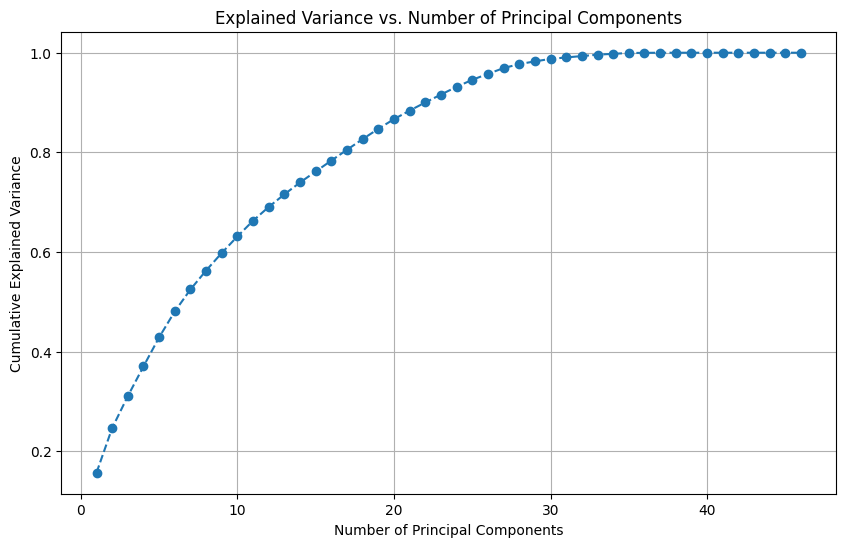

5 Components explain: 42.88% variance
10 Components explain: 63.13% variance
20 Components explain: 86.67% variance
30 Components explain: 98.77% variance
40 Components explain: 100.00% variance


In [76]:
# Sample a subset (20,000 rows) to avoid memory issues
df_sample = resample(new_data, n_samples=20000, random_state=42)

# Standardize numerical data
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df_sample)

# Apply PCA
pca = PCA()
pca_components = pca.fit_transform(df_scaled)

# Get explained variance ratio
explained_variance_ratio = pca.explained_variance_ratio_

# Plot cumulative explained variance
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(explained_variance_ratio) + 1), explained_variance_ratio.cumsum(), marker='o', linestyle='--')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance vs. Number of Principal Components')
plt.grid(True)
plt.show()

# Print variance explained by top components
for i in [5, 10, 20, 30, 40, 50]:
    if i <= len(explained_variance_ratio):
        print(f"{i} Components explain: {explained_variance_ratio[:i].sum() * 100:.2f}% variance")


In [77]:
# Define features and target variable
X = new_data.drop(columns=['fraud'])  # Remove target column
y = new_data['fraud']

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Apply PCA
n_components = 20  # Choose based on explained variance analysis
pca = PCA(n_components=n_components)
X_pca = pca.fit_transform(X_scaled)

# Split data
xpca_train, xpca_test, ypca_train, ypca_test = train_test_split(X_pca, y, test_size=0.2, random_state=42)

# Print confirmation
print(f"PCA Applied: {n_components} components used.")
print(f"xPCA_train shape: {xpca_train.shape}, xPCA_test shape: {xpca_test.shape}")
print(f"yPCA_train shape: {ypca_train.shape}, yPCA_test shape: {ypca_test.shape}")

# Create an empty list to store results
results = []

# Loop through models and run classification
for name_f, model_f in models_f:
    print(f"\n====== Running Model: {name_f} ======")
    classifiermodel(model_f, xpca_train, xpca_test, ypca_train, ypca_test)

# Convert results to a dataframe
pca_model_results = pd.DataFrame(results, columns=[
    "Classification Model",
    "Training Accuracy Score",
    "Test Accuracy Score",
    "Recall Score", 
    "Precision Score", 
    "F1 Score"
])

pca_model_results['Interventions'] = 'PCA'
pca_model_results['Features'] = xpca_train.shape[1]

# concatenate the summary to the main result dataframe
df_prediction_results = pd.concat([df_prediction_results, pca_model_results], ignore_index=True)

df_prediction_results



PCA Applied: 20 components used.
xPCA_train shape: (144415, 20), xPCA_test shape: (36104, 20)
yPCA_train shape: (144415,), yPCA_test shape: (36104,)

====== Running Model: K Nearest Neighbour ======

Model parameters used for fraud detection:
KNeighborsClassifier()
Training Accuracy: 98.06%
Test Accuracy: 97.63%
Recall Score: 3.65%
Precision Score: 45.59%
F1 score of fraud detection: 6.75%
Confusion Matrix of fraud detection:
[[35217    37]
 [  819    31]]


====== Running Model: Decision Tree ======

Model parameters used for fraud detection:
DecisionTreeClassifier(max_depth=10, min_samples_leaf=5, min_samples_split=10)
Training Accuracy: 98.47%
Test Accuracy: 98.02%
Recall Score: 35.88%
Precision Score: 64.08%
F1 score of fraud detection: 46.00%
Confusion Matrix of fraud detection:
[[35083   171]
 [  545   305]]


====== Running Model: Random Forest ======

Model parameters used for fraud detection:
RandomForestClassifier(max_depth=10, min_samples_leaf=5, min_samples_split=10)
Traini

,Classification Model,Interventions,Features,Training Accuracy Score,Test Accuracy Score,Recall Score,Precision Score,F1 Score
0,KNeighborsClassifier,null,45,98.100000,97.680000,4.82000,60.290000,8.930000
1,DecisionTreeClassifier,null,45,98.480000,98.270000,44.12000,71.430000,54.550000
2,RandomForestClassifier,null,45,97.780000,97.650000,0.00000,100.000000,0.000000
3,LogisticRegression,null,45,97.890000,97.760000,18.82000,57.760000,28.390000
4,ExtraTreesClassifier,null,45,97.780000,97.650000,0.00000,100.000000,0.000000
5,XGBClassifier,null,45,98.740000,98.470000,45.06000,82.010000,58.160000
6,XGBClassifier,Hyperparameter Tuned XGBoost,45,100.000000,99.390000,78.59000,94.750000,85.920000
7,Neural Network,null,45,97.775853,97.645688,97.64569,95.346808,96.482557
8,KNeighborsClassifier,PCA,20,98.060000,97.630000,3.65000,45.590000,6.750000
9,DecisionTreeClassifier,PCA,20,98.470000,98.020000,35.88000,64.080000,46.000000


In [78]:
df_prediction_results

,Classification Model,Interventions,Features,Training Accuracy Score,Test Accuracy Score,Recall Score,Precision Score,F1 Score
0,KNeighborsClassifier,null,45,98.100000,97.680000,4.82000,60.290000,8.930000
1,DecisionTreeClassifier,null,45,98.480000,98.270000,44.12000,71.430000,54.550000
2,RandomForestClassifier,null,45,97.780000,97.650000,0.00000,100.000000,0.000000
3,LogisticRegression,null,45,97.890000,97.760000,18.82000,57.760000,28.390000
4,ExtraTreesClassifier,null,45,97.780000,97.650000,0.00000,100.000000,0.000000
5,XGBClassifier,null,45,98.740000,98.470000,45.06000,82.010000,58.160000
6,XGBClassifier,Hyperparameter Tuned XGBoost,45,100.000000,99.390000,78.59000,94.750000,85.920000
7,Neural Network,null,45,97.775853,97.645688,97.64569,95.346808,96.482557
8,KNeighborsClassifier,PCA,20,98.060000,97.630000,3.65000,45.590000,6.750000
9,DecisionTreeClassifier,PCA,20,98.470000,98.020000,35.88000,64.080000,46.000000


In [79]:
# define neural network infrastructure
keras.layers.BatchNormalization()
classifier = Sequential()
#First Hidden Layer
classifier.add(Dense(1024, activation='relu',kernel_initializer='random_normal', input_dim=20)) 
#Third Hidden Layer
classifier.add(Dense(512, activation='relu',kernel_initializer='random_normal'))
#Fourth Hidden Layer
classifier.add(Dense(256, activation='relu',kernel_initializer='random_normal'))
#Fifth Hidden Layer
classifier.add(Dense(128, activation='relu',kernel_initializer='random_normal'))
#Sixth Hidden Layer
classifier.add(Dense(64, activation='relu',kernel_initializer='random_normal'))
#Seventh Hidden Layer
classifier.add(Dense(32, activation='relu',kernel_initializer='random_normal'))
#Eight Hidden Layer
classifier.add(Dense(16, activation='relu',kernel_initializer='random_normal'))
#Ninth Hidden Layer
classifier.add(Dense(8, activation='relu',kernel_initializer='random_normal'))
#Tenth Hidden Layer
classifier.add(Dense(4, activation='relu',kernel_initializer='random_normal'))
#Eleventh Hidden Layer
classifier.add(Dense(2, activation='relu',kernel_initializer='random_normal'))
#Output Layer
classifier.add(Dense(1, activation='sigmoid',kernel_initializer='random_normal'))

classifier.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])
classifier.summary()


/opt/conda/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_11 (Dense)                │ (None, 1024)           │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_12 (Dense)                │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_14 (Dense)                │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_15 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_16 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_17 (Dense)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_18 (Dense)                │ (None, 8)              │           136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_19 (Dense)                │ (None, 4)              │            36 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_20 (Dense)                │ (None, 2)              │            10 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_21 (Dense)                │ (None, 1)              │             3 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 721,577 (2.75 MB)

 Trainable params: 721,577 (2.75 MB)

 Non-trainable params: 0 (0.00 B)

In [80]:
#Fitting the data to the training dataset
classifier.fit(xpca_train, ypca_train, batch_size=512, epochs=10, validation_split=0.15, verbose=1)


train_evaluate=classifier.evaluate(xpca_train, ypca_train)
test_evaluate=classifier.evaluate(xpca_test, ypca_test)

print('accuracy for Train set is',train_evaluate)
print('accuracy for Test set is',test_evaluate)

ypca_pred1=classifier.predict(xpca_test,batch_size=512,verbose=1)
ypca_pred=np.argmax(ypca_pred1,axis=1)

print(f1_score(ypca_test,ypca_pred,average="weighted"))

# Compute metrics
train_accuracy = train_evaluate[1]
test_accuracy = test_evaluate[1]
recall = recall_score(ypca_test, ypca_pred, average="weighted")
precision = precision_score(yf_test, yf_pred, average="weighted", zero_division=0)
f1 = f1_score(ypca_test, ypca_pred, average="weighted")

# Creating a summary DataFrame
summary = pd.DataFrame({
    "Classification Model": ["Neural Network"],
    "Interventions": 'PCA',
    "Features": xpca_train.shape[1],
    "Training Accuracy Score": [train_accuracy*100],
    "Test Accuracy Score": [test_accuracy * 100],
    "Recall Score": [recall * 100],
    "Precision Score": [precision * 100],
    "F1 Score": [f1 * 100]
})


# concatenate the summary to the main result dataframe
df_prediction_results = pd.concat([df_prediction_results, summary], ignore_index=True)

df_prediction_results

Epoch 1/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 23s 82ms/step - accuracy: 0.9786 - loss: 0.6655 - val_accuracy: 0.9760 - val_loss: 0.5889
Epoch 2/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 75ms/step - accuracy: 0.9780 - loss: 0.5657 - val_accuracy: 0.9760 - val_loss: 0.5032
Epoch 3/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 77ms/step - accuracy: 0.9779 - loss: 0.4838 - val_accuracy: 0.9760 - val_loss: 0.4333
Epoch 4/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 75ms/step - accuracy: 0.9784 - loss: 0.4165 - val_accuracy: 0.9760 - val_loss: 0.3763
Epoch 5/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 73ms/step - accuracy: 0.9781 - loss: 0.3621 - val_accuracy: 0.9760 - val_loss: 0.3298
Epoch 6/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 73ms/step - accuracy: 0.9783 - loss: 0.3173 - val_accuracy: 0.9760 - val_loss: 0.2919
Epoch 7/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 75ms/step - accuracy: 0.9779 - loss: 0.2814 - val_accuracy: 0.9760 - val_loss: 0.2608
Epoch 8/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 74ms/step - accuracy: 0.9777 - loss: 0.2517 - 

,Classification Model,Interventions,Features,Training Accuracy Score,Test Accuracy Score,Recall Score,Precision Score,F1 Score
0,KNeighborsClassifier,null,45,98.100000,97.680000,4.82000,60.290000,8.930000
1,DecisionTreeClassifier,null,45,98.480000,98.270000,44.12000,71.430000,54.550000
2,RandomForestClassifier,null,45,97.780000,97.650000,0.00000,100.000000,0.000000
3,LogisticRegression,null,45,97.890000,97.760000,18.82000,57.760000,28.390000
4,ExtraTreesClassifier,null,45,97.780000,97.650000,0.00000,100.000000,0.000000
5,XGBClassifier,null,45,98.740000,98.470000,45.06000,82.010000,58.160000
6,XGBClassifier,Hyperparameter Tuned XGBoost,45,100.000000,99.390000,78.59000,94.750000,85.920000
7,Neural Network,null,45,97.775853,97.645688,97.64569,95.346808,96.482557
8,KNeighborsClassifier,PCA,20,98.060000,97.630000,3.65000,45.590000,6.750000
9,DecisionTreeClassifier,PCA,20,98.470000,98.020000,35.88000,64.080000,46.000000


Scores dont change much, but feature number is significantly dropped to half

## 4.3 Feature Importance

/tmp/ipykernel_10593/2267723035.py:15: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




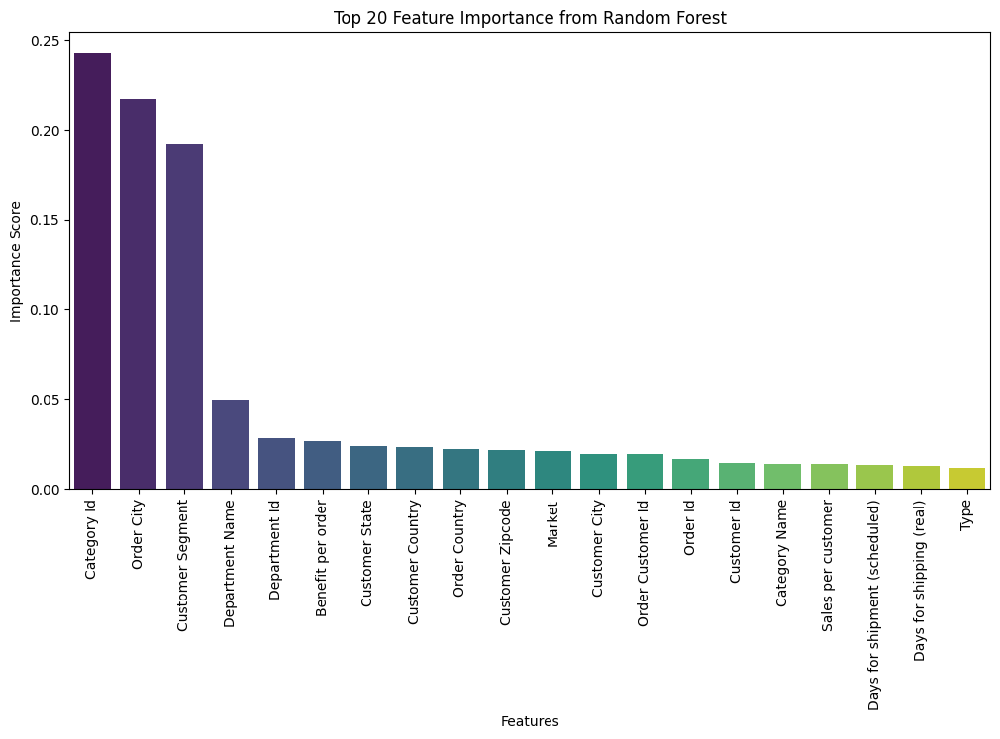

In [81]:
# Get feature importance scores from the trained model
important_col = model_f.feature_importances_.argsort()[::-1]  # Sort in descending order

# Create a DataFrame to store feature importance
feat_imp = pd.DataFrame({
    'Variables': xf.columns[important_col],  # Use sorted indices
    'Importance': model_f.feature_importances_[important_col]
})

# Select the top 20 features
feat_imp = feat_imp.head(20)

# Plot feature importance
plt.figure(figsize=(12, 6))
sns.barplot(x='Variables', y='Importance', data=feat_imp, palette="viridis")
plt.xticks(rotation=90)
plt.xlabel("Features")
plt.ylabel("Importance Score")
plt.title("Top 20 Feature Importance from Random Forest")
plt.show()


In [82]:
# Extract only the top 20 important features from xf and rename it to xfi
top_features = feat_imp["Variables"].tolist()  # Get the list of top 20 features
xfi = xf[top_features]  # Select only these features


xfi

,Category Id,Order City,Customer Segment,Department Name,Department Id,Benefit per order,Customer State,Customer Country,Order Country,Customer Zipcode,Market,Customer City,Order Customer Id,Order Id,Customer Id,Category Name,Sales per customer,Days for shipment (scheduled),Days for shipping (real),Type
0,73,331,0,4,2,91.250000,36,1,70,725.0,3,66,20755,77202,20755,40,314.640015,4,3,1
1,73,391,0,4,2,-249.089996,36,1,69,725.0,3,66,19492,75939,19492,40,311.359985,4,5,3
2,73,391,0,4,2,-247.779999,5,0,69,95125.0,3,452,19491,75938,19491,40,309.720001,4,4,0
3,73,3226,2,4,2,22.860001,5,0,8,90027.0,3,285,19490,75937,19490,40,304.809998,4,3,1
4,73,3226,1,4,2,134.210007,36,1,8,725.0,3,66,19489,75936,19489,40,298.250000,4,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
180514,45,2922,2,3,7,40.000000,31,0,31,11207.0,3,59,1005,26043,1005,18,399.980011,4,4,0
180515,45,1362,1,3,7,-613.770019,5,0,77,93304.0,3,26,9141,26037,9141,18,395.980011,2,3,1
180516,45,25,1,3,7,141.110001,7,0,8,6010.0,3,55,291,26024,291,18,391.980011,4,5,3
180517,45,25,0,3,7,186.229996,36,1,8,725.0,3,66,2813,26022,2813,18,387.980011,4,3,2


In [83]:
yfi = yf.copy()
yf

0         0
1         0
2         0
3         0
4         0
         ..
180514    0
180515    0
180516    0
180517    0
180518    0
Name: fraud, Length: 180519, dtype: int64

In [84]:
#Splitting the data into two parts in which 80% data will be used for training the model and 20% for testing
xfi_train, xfi_test,yfi_train,yfi_test = train_test_split(xfi,yfi,test_size = 0.2,random_state = 42)

sc = StandardScaler()
xfi_train=sc.fit_transform(xfi_train)
xfi_test=sc.transform(xfi_test)

# Create an empty list to store results
results = []


# Loop through models and run classification
for name_f, model_f in models_f:
    print(f"\n====== Running Model: {name_f} ======")
    classifiermodel(model_f, xfi_train, xfi_test, yfi_train, yfi_test)


# Convert results to a DataFrame
fi_model_results = pd.DataFrame(results, columns=[
    "Classification Model",
    "Training Accuracy Score",
    "Test Accuracy Score", 
    "Recall Score", 
    "Precision Score", 
    "F1 Score"
])

fi_model_results['Interventions'] = 'Feature Importance'
fi_model_results['Features'] = xfi_train.shape[1]

# concatenate the summary to the main result dataframe
df_prediction_results = pd.concat([df_prediction_results, fi_model_results], ignore_index=True)

df_prediction_results


====== Running Model: K Nearest Neighbour ======

Model parameters used for fraud detection:
KNeighborsClassifier()
Training Accuracy: 97.98%
Test Accuracy: 97.56%
Recall Score: 2.35%
Precision Score: 28.17%
F1 score of fraud detection: 4.34%
Confusion Matrix of fraud detection:
[[35203    51]
 [  830    20]]


====== Running Model: Decision Tree ======

Model parameters used for fraud detection:
DecisionTreeClassifier(max_depth=10, min_samples_leaf=5, min_samples_split=10)
Training Accuracy: 97.98%
Test Accuracy: 97.70%
Recall Score: 7.06%
Precision Score: 60.00%
F1 score of fraud detection: 12.63%
Confusion Matrix of fraud detection:
[[35214    40]
 [  790    60]]


====== Running Model: Random Forest ======

Model parameters used for fraud detection:
RandomForestClassifier(max_depth=10, min_samples_leaf=5, min_samples_split=10)
Training Accuracy: 97.78%
Test Accuracy: 97.65%
Recall Score: 0.00%
Precision Score: 100.00%
F1 score of fraud detection: 0.00%
Confusion Matrix of fraud de

,Classification Model,Interventions,Features,Training Accuracy Score,Test Accuracy Score,Recall Score,Precision Score,F1 Score
0,KNeighborsClassifier,null,45,98.100000,97.680000,4.82000,60.290000,8.930000
1,DecisionTreeClassifier,null,45,98.480000,98.270000,44.12000,71.430000,54.550000
2,RandomForestClassifier,null,45,97.780000,97.650000,0.00000,100.000000,0.000000
3,LogisticRegression,null,45,97.890000,97.760000,18.82000,57.760000,28.390000
4,ExtraTreesClassifier,null,45,97.780000,97.650000,0.00000,100.000000,0.000000
5,XGBClassifier,null,45,98.740000,98.470000,45.06000,82.010000,58.160000
6,XGBClassifier,Hyperparameter Tuned XGBoost,45,100.000000,99.390000,78.59000,94.750000,85.920000
7,Neural Network,null,45,97.775853,97.645688,97.64569,95.346808,96.482557
8,KNeighborsClassifier,PCA,20,98.060000,97.630000,3.65000,45.590000,6.750000
9,DecisionTreeClassifier,PCA,20,98.470000,98.020000,35.88000,64.080000,46.000000


In [85]:
# define neural network insfrastructure
keras.layers.BatchNormalization()
classifier = Sequential()
#First Hidden Layer
classifier.add(Dense(1024, activation='relu',kernel_initializer='random_normal', input_dim=20)) 
#Third Hidden Layer
classifier.add(Dense(512, activation='relu',kernel_initializer='random_normal'))
#Fourth Hidden Layer
classifier.add(Dense(256, activation='relu',kernel_initializer='random_normal'))
#Fifth Hidden Layer
classifier.add(Dense(128, activation='relu',kernel_initializer='random_normal'))
#Sixth Hidden Layer
classifier.add(Dense(64, activation='relu',kernel_initializer='random_normal'))
#Seventh Hidden Layer
classifier.add(Dense(32, activation='relu',kernel_initializer='random_normal'))
#Eight Hidden Layer
classifier.add(Dense(16, activation='relu',kernel_initializer='random_normal'))
#Ninth Hidden Layer
classifier.add(Dense(8, activation='relu',kernel_initializer='random_normal'))
#Tenth Hidden Layer
classifier.add(Dense(4, activation='relu',kernel_initializer='random_normal'))
#Eleventh Hidden Layer
classifier.add(Dense(2, activation='relu',kernel_initializer='random_normal'))
#Output Layer
classifier.add(Dense(1, activation='sigmoid',kernel_initializer='random_normal'))

classifier.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])
classifier.summary()


/opt/conda/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_22 (Dense)                │ (None, 1024)           │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_23 (Dense)                │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_24 (Dense)                │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_25 (Dense)                │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_26 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_27 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_28 (Dense)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_29 (Dense)                │ (None, 8)              │           136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_30 (Dense)                │ (None, 4)              │            36 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_31 (Dense)                │ (None, 2)              │            10 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_32 (Dense)                │ (None, 1)              │             3 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 721,577 (2.75 MB)

 Trainable params: 721,577 (2.75 MB)

 Non-trainable params: 0 (0.00 B)

In [86]:
#Fitting the data to the training dataset
classifier.fit(xfi_train, yfi_train, batch_size=512, epochs=10, validation_split=0.15, verbose=1)


train_evaluate=classifier.evaluate(xfi_train, yfi_train)
test_evaluate=classifier.evaluate(xfi_test, yfi_test)

print('accuracy for Train set is',train_evaluate)
print('accuracy for Test set is',test_evaluate)

yfi_pred1=classifier.predict(xfi_test,batch_size=512,verbose=1)
yfi_pred=np.argmax(yfi_pred1,axis=1)

print(f1_score(yfi_test,yfi_pred,average="weighted"))

# Compute metrics
train_accuracy = train_evaluate[1]
test_accuracy = test_evaluate[1]
recall = recall_score(yfi_test, yfi_pred, average="weighted")
precision = precision_score(yf_test, yf_pred, average="weighted", zero_division = 1)  
f1 = f1_score(yfi_test, yfi_pred, average="weighted")

# Creating a summary DataFrame in the same format as your previous table
summary = pd.DataFrame({
    "Classification Model": ["Neural Network"],
    "Interventions": 'Feature Importance',
    "Features": xfi_train.shape[1],
    "Training Accuracy Score": [train_accuracy*100],
    "Test Accuracy Score": [test_accuracy * 100],
    "Recall Score": [recall * 100],
    "Precision Score": [precision * 100],
    "F1 Score": [f1 * 100]
})

# concatenate the summary to the main result dataframe
df_prediction_results = pd.concat([df_prediction_results, summary], ignore_index=True)

df_prediction_results

Epoch 1/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 21s 76ms/step - accuracy: 0.9781 - loss: 0.4898 - val_accuracy: 0.9760 - val_loss: 0.0859
Epoch 2/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 19s 79ms/step - accuracy: 0.9775 - loss: 0.0807 - val_accuracy: 0.9760 - val_loss: 0.0842
Epoch 3/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 19s 77ms/step - accuracy: 0.9784 - loss: 0.0768 - val_accuracy: 0.9760 - val_loss: 0.0833
Epoch 4/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 19s 80ms/step - accuracy: 0.9779 - loss: 0.0765 - val_accuracy: 0.9760 - val_loss: 0.0845
Epoch 5/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 19s 79ms/step - accuracy: 0.9781 - loss: 0.0759 - val_accuracy: 0.9760 - val_loss: 0.0824
Epoch 6/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 75ms/step - accuracy: 0.9777 - loss: 0.0757 - val_accuracy: 0.9760 - val_loss: 0.0853
Epoch 7/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 76ms/step - accuracy: 0.9780 - loss: 0.0750 - val_accuracy: 0.9760 - val_loss: 0.0846
Epoch 8/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 18s 76ms/step - accuracy: 0.9781 - loss: 0.0738 - 

,Classification Model,Interventions,Features,Training Accuracy Score,Test Accuracy Score,Recall Score,Precision Score,F1 Score
0,KNeighborsClassifier,null,45,98.100000,97.680000,4.82000,60.290000,8.930000
1,DecisionTreeClassifier,null,45,98.480000,98.270000,44.12000,71.430000,54.550000
2,RandomForestClassifier,null,45,97.780000,97.650000,0.00000,100.000000,0.000000
3,LogisticRegression,null,45,97.890000,97.760000,18.82000,57.760000,28.390000
4,ExtraTreesClassifier,null,45,97.780000,97.650000,0.00000,100.000000,0.000000
5,XGBClassifier,null,45,98.740000,98.470000,45.06000,82.010000,58.160000
6,XGBClassifier,Hyperparameter Tuned XGBoost,45,100.000000,99.390000,78.59000,94.750000,85.920000
7,Neural Network,null,45,97.775853,97.645688,97.64569,95.346808,96.482557
8,KNeighborsClassifier,PCA,20,98.060000,97.630000,3.65000,45.590000,6.750000
9,DecisionTreeClassifier,PCA,20,98.470000,98.020000,35.88000,64.080000,46.000000


## 4.4 Handling Overfitting: Imbalance Data

In [87]:
# define neural network insfrastructure
keras.layers.BatchNormalization()
classifier = Sequential()
#First Hidden Layer
classifier.add(Dense(1024, activation='relu',kernel_initializer='random_normal', input_dim=45)) 
#Third Hidden Layer
classifier.add(Dense(512, activation='relu',kernel_initializer='random_normal'))
#Fourth Hidden Layer
classifier.add(Dense(256, activation='relu',kernel_initializer='random_normal'))
#Fifth Hidden Layer
classifier.add(Dense(128, activation='relu',kernel_initializer='random_normal'))
#Sixth Hidden Layer
classifier.add(Dense(64, activation='relu',kernel_initializer='random_normal'))
#Seventh Hidden Layer
classifier.add(Dense(32, activation='relu',kernel_initializer='random_normal'))
#Eight Hidden Layer
classifier.add(Dense(16, activation='relu',kernel_initializer='random_normal'))
#Ninth Hidden Layer
classifier.add(Dense(8, activation='relu',kernel_initializer='random_normal'))
#Tenth Hidden Layer
classifier.add(Dense(4, activation='relu',kernel_initializer='random_normal'))
#Eleventh Hidden Layer
classifier.add(Dense(2, activation='relu',kernel_initializer='random_normal'))
#Output Layer
classifier.add(Dense(1, activation='sigmoid',kernel_initializer='random_normal'))

classifier.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])
classifier.summary()


/opt/conda/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_33 (Dense)                │ (None, 1024)           │        47,104 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_34 (Dense)                │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_35 (Dense)                │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_36 (Dense)                │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_37 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_38 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_39 (Dense)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_40 (Dense)                │ (None, 8)              │           136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_41 (Dense)                │ (None, 4)              │            36 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_42 (Dense)                │ (None, 2)              │            10 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_43 (Dense)                │ (None, 1)              │             3 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 747,177 (2.85 MB)

 Trainable params: 747,177 (2.85 MB)

 Non-trainable params: 0 (0.00 B)

In [88]:
# Separate features and target
xfimb = train_data.drop(columns=['fraud'])
yfimb = train_data['fraud']

# Split before resampling
xf_train, xf_test, yf_train, yf_test = train_test_split(xfimb, yfimb, test_size=0.2, random_state=42, stratify=yf)

# Define different sampling strategies to test
sampling_strategies = ['auto'] #after several test, 'auto' is the best strategy
# sampling_strategies = [0.2, 0.3, 0.4, 0.5, 'auto'] #we tested different sampling strategies the first time


for strategy in sampling_strategies:
    print(f"\n🔄 Testing SMOTE with sampling_strategy = {strategy} 🔄")
    
    # Step 2: Apply SMOTE
    smote = SMOTE(sampling_strategy=strategy, random_state=42)
    xf_train_resampled, yf_train_resampled = smote.fit_resample(xf_train, yf_train)

    print("Before SMOTE:", Counter(yf_train))
    print("After SMOTE:", Counter(yf_train_resampled))

    # Step 3: Apply Standard Scaling
    sc = StandardScaler()
    xf_train_resampled = sc.fit_transform(xf_train_resampled)
    xf_test_scaled = sc.transform(xf_test)

    # # Step 4: Define Neural Network
    # classifier = Sequential()
    # classifier.add(Dense(1024, activation='relu', kernel_initializer='random_normal', input_dim=xf_train_resampled.shape[1])) 
    # classifier.add(Dense(512, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(256, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(128, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(64, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(32, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(16, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(8, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(4, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(2, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(1, activation='sigmoid', kernel_initializer='random_normal'))

    # classifier.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    # classifier.summary()

    # Step 5: Train the Model
    classifier.fit(xf_train_resampled, yf_train_resampled, batch_size=512, epochs=10, validation_split=0.15, verbose=1)

    # Step 6: Evaluate Model
    train_evaluate = classifier.evaluate(xf_train_resampled, yf_train_resampled)
    test_evaluate = classifier.evaluate(xf_test_scaled, yf_test)
    
    print(f'Accuracy for Train set: {train_evaluate[1]:.4f}')
    print(f'Accuracy for Test set: {test_evaluate[1]:.4f}')
    
    # Step 7: Predictions & Metrics
    yfi_pred_probs = classifier.predict(xf_test_scaled, batch_size=512, verbose=1)
    yfi_pred = (yfi_pred_probs > 0.5).astype(int).flatten()

    train_accuracy = train_evaluate[1]
    test_accuracy = test_evaluate[1]
    recall = recall_score(yf_test, yf_pred, average="weighted")
    precision = precision_score(yf_test, yf_pred, average="weighted", zero_division=1)
    f1 = f1_score(yf_test, yf_pred, average="weighted")

    # Step 8: Store Results
    summary = pd.DataFrame({
        "Classification Model": ["Neural Network"],
        "Interventions": [f'Oversampling + {strategy}'],
        "Features": [xf_train_resampled.shape[1]],
        "Training Accuracy Score": [train_accuracy*100],
        "Test Accuracy Score": [test_accuracy * 100],
        "Recall Score": [recall * 100],
        "Precision Score": [precision * 100],
        "F1 Score": [f1 * 100]
    })

    df_prediction_results = pd.concat([df_prediction_results, summary], ignore_index=True)

df_prediction_results


🔄 Testing SMOTE with sampling_strategy = auto 🔄
Before SMOTE: Counter({0: 141165, 1: 3250})
After SMOTE: Counter({0: 141165, 1: 141165})
Epoch 1/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 41s 78ms/step - accuracy: 0.7151 - loss: 0.4945 - val_accuracy: 0.9735 - val_loss: 0.5465
Epoch 2/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 37s 80ms/step - accuracy: 0.9571 - loss: 0.2470 - val_accuracy: 0.9895 - val_loss: 0.3908
Epoch 3/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 37s 79ms/step - accuracy: 0.9682 - loss: 0.1890 - val_accuracy: 0.9894 - val_loss: 0.2939
Epoch 4/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 35s 75ms/step - accuracy: 0.9769 - loss: 0.1445 - val_accuracy: 0.9971 - val_loss: 0.2145
Epoch 5/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 36s 77ms/step - accuracy: 0.9826 - loss: 0.1126 - val_accuracy: 0.9979 - val_loss: 0.1639
Epoch 6/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 36s 76ms/step - accuracy: 0.9865 - loss: 0.0881 - val_accuracy: 0.9979 - val_loss: 0.1281
Epoch 7/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 36s 76ms/step - accuracy: 0.9884 - loss: 0

,Classification Model,Interventions,Features,Training Accuracy Score,Test Accuracy Score,Recall Score,Precision Score,F1 Score
0,KNeighborsClassifier,null,45,98.100000,97.680000,4.820000,60.290000,8.930000
1,DecisionTreeClassifier,null,45,98.480000,98.270000,44.120000,71.430000,54.550000
2,RandomForestClassifier,null,45,97.780000,97.650000,0.000000,100.000000,0.000000
3,LogisticRegression,null,45,97.890000,97.760000,18.820000,57.760000,28.390000
4,ExtraTreesClassifier,null,45,97.780000,97.650000,0.000000,100.000000,0.000000
5,XGBClassifier,null,45,98.740000,98.470000,45.060000,82.010000,58.160000
6,XGBClassifier,Hyperparameter Tuned XGBoost,45,100.000000,99.390000,78.590000,94.750000,85.920000
7,Neural Network,null,45,97.775853,97.645688,97.645690,95.346808,96.482557
8,KNeighborsClassifier,PCA,20,98.060000,97.630000,3.650000,45.590000,6.750000
9,DecisionTreeClassifier,PCA,20,98.470000,98.020000,35.880000,64.080000,46.000000


In [89]:

# Separate features and target
xfimp = train_data.drop(columns=['fraud'])
yfimp = train_data['fraud']

# Extract only the top 20 important features from xf and rename it to xfi
top_features = feat_imp["Variables"].tolist()  # Get the list of top 20 features
xfimp = xfimp[top_features]  # Select only these features


xfimp

,Category Id,Order City,Customer Segment,Department Name,Department Id,Benefit per order,Customer State,Customer Country,Order Country,Customer Zipcode,Market,Customer City,Order Customer Id,Order Id,Customer Id,Category Name,Sales per customer,Days for shipment (scheduled),Days for shipping (real),Type
0,73,331,0,4,2,91.250000,36,1,70,725.0,3,66,20755,77202,20755,40,314.640015,4,3,1
1,73,391,0,4,2,-249.089996,36,1,69,725.0,3,66,19492,75939,19492,40,311.359985,4,5,3
2,73,391,0,4,2,-247.779999,5,0,69,95125.0,3,452,19491,75938,19491,40,309.720001,4,4,0
3,73,3226,2,4,2,22.860001,5,0,8,90027.0,3,285,19490,75937,19490,40,304.809998,4,3,1
4,73,3226,1,4,2,134.210007,36,1,8,725.0,3,66,19489,75936,19489,40,298.250000,4,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
180514,45,2922,2,3,7,40.000000,31,0,31,11207.0,3,59,1005,26043,1005,18,399.980011,4,4,0
180515,45,1362,1,3,7,-613.770019,5,0,77,93304.0,3,26,9141,26037,9141,18,395.980011,2,3,1
180516,45,25,1,3,7,141.110001,7,0,8,6010.0,3,55,291,26024,291,18,391.980011,4,5,3
180517,45,25,0,3,7,186.229996,36,1,8,725.0,3,66,2813,26022,2813,18,387.980011,4,3,2


In [90]:
# define neural network insfrastructure
keras.layers.BatchNormalization()
classifier = Sequential()
#First Hidden Layer
classifier.add(Dense(1024, activation='relu',kernel_initializer='random_normal', input_dim=20)) 
#Third Hidden Layer
classifier.add(Dense(512, activation='relu',kernel_initializer='random_normal'))
#Fourth Hidden Layer
classifier.add(Dense(256, activation='relu',kernel_initializer='random_normal'))
#Fifth Hidden Layer
classifier.add(Dense(128, activation='relu',kernel_initializer='random_normal'))
#Sixth Hidden Layer
classifier.add(Dense(64, activation='relu',kernel_initializer='random_normal'))
#Seventh Hidden Layer
classifier.add(Dense(32, activation='relu',kernel_initializer='random_normal'))
#Eight Hidden Layer
classifier.add(Dense(16, activation='relu',kernel_initializer='random_normal'))
#Ninth Hidden Layer
classifier.add(Dense(8, activation='relu',kernel_initializer='random_normal'))
#Tenth Hidden Layer
classifier.add(Dense(4, activation='relu',kernel_initializer='random_normal'))
#Eleventh Hidden Layer
classifier.add(Dense(2, activation='relu',kernel_initializer='random_normal'))
#Output Layer
classifier.add(Dense(1, activation='sigmoid',kernel_initializer='random_normal'))

classifier.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])
classifier.summary()


/opt/conda/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_44 (Dense)                │ (None, 1024)           │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_45 (Dense)                │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_46 (Dense)                │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_47 (Dense)                │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_48 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_49 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_50 (Dense)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_51 (Dense)                │ (None, 8)              │           136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_52 (Dense)                │ (None, 4)              │            36 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_53 (Dense)                │ (None, 2)              │            10 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_54 (Dense)                │ (None, 1)              │             3 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 721,577 (2.75 MB)

 Trainable params: 721,577 (2.75 MB)

 Non-trainable params: 0 (0.00 B)

In [91]:
# Split before resampling
xfis_train, xfis_test, yfis_train, yfis_test = train_test_split(xfimp, yfimp, test_size=0.2, random_state=42, stratify=yf)

# Define different sampling strategies to test
sampling_strategies = ['auto'] #after several test, 'auto' is the best strategy
# sampling_strategies = [0.2, 0.3, 0.4, 0.5, 'auto'] #we tested different sampling strategies the first time


for strategy in sampling_strategies:
    print(f"\n🔄 Testing SMOTE with sampling_strategy = {strategy} 🔄")
    
    # Step 2: Apply SMOTE
    smote = SMOTE(sampling_strategy=strategy, random_state=42)
    xfis_train_resampled, yfis_train_resampled = smote.fit_resample(xfis_train, yfis_train)

    print("Before SMOTE:", Counter(yf_train))
    print("After SMOTE:", Counter(yf_train_resampled))

    # Step 3: Apply Standard Scaling
    sc = StandardScaler()
    xfis_train_resampled = sc.fit_transform(xfis_train_resampled)
    xfis_test_scaled = sc.transform(xfis_test)

    # # Step 4: Define Neural Network
    # classifier = Sequential()
    # classifier.add(Dense(1024, activation='relu', kernel_initializer='random_normal', input_dim=xf_train_resampled.shape[1])) 
    # classifier.add(Dense(512, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(256, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(128, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(64, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(32, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(16, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(8, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(4, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(2, activation='relu', kernel_initializer='random_normal'))
    # classifier.add(Dense(1, activation='sigmoid', kernel_initializer='random_normal'))

    # classifier.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    # classifier.summary()

    # Step 5: Train the Model
    classifier.fit(xfis_train_resampled, yfis_train_resampled, batch_size=512, epochs=10, validation_split=0.15, verbose=1)

    # Step 6: Evaluate Model
    train_evaluate = classifier.evaluate(xfis_train_resampled, yfis_train_resampled)
    test_evaluate = classifier.evaluate(xfis_test_scaled, yfis_test)
    
    print(f'Accuracy for Train set: {train_evaluate[1]:.4f}')
    print(f'Accuracy for Test set: {test_evaluate[1]:.4f}')
    
    # Step 7: Predictions & Metrics
    yfis_pred_probs = classifier.predict(xfis_test_scaled, batch_size=512, verbose=1)
    yfis_pred = (yfis_pred_probs > 0.5).astype(int).flatten()

    train_accuracy = train_evaluate[1]
    test_accuracy = test_evaluate[1]
    recall = recall_score(yfis_test, yfis_pred, average="weighted")
    precision = precision_score(yfis_test, yfis_pred, average="weighted", zero_division=1)
    f1 = f1_score(yfis_test, yfis_pred, average="weighted")

    # Step 8: Store Results
    summary = pd.DataFrame({
        "Classification Model": ["Neural Network"],
        "Interventions": [f'Feature Importance & Oversampling + {strategy}'],
        "Features": [xfis_train_resampled.shape[1]],
        "Training Accuracy Score": [train_accuracy*100],
        "Test Accuracy Score": [test_accuracy * 100],
        "Recall Score": [recall * 100],
        "Precision Score": [precision * 100],
        "F1 Score": [f1 * 100]
    })

    df_prediction_results = pd.concat([df_prediction_results, summary], ignore_index=True)

df_prediction_results


🔄 Testing SMOTE with sampling_strategy = auto 🔄
Before SMOTE: Counter({0: 141165, 1: 3250})
After SMOTE: Counter({0: 141165, 1: 141165})
Epoch 1/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 42s 79ms/step - accuracy: 0.6721 - loss: 0.5361 - val_accuracy: 0.9784 - val_loss: 0.5614
Epoch 2/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 36s 77ms/step - accuracy: 0.8627 - loss: 0.3416 - val_accuracy: 0.9692 - val_loss: 0.4321
Epoch 3/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 36s 77ms/step - accuracy: 0.8908 - loss: 0.2905 - val_accuracy: 0.9638 - val_loss: 0.3490
Epoch 4/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 35s 74ms/step - accuracy: 0.9102 - loss: 0.2494 - val_accuracy: 0.9423 - val_loss: 0.3145
Epoch 5/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 35s 74ms/step - accuracy: 0.9365 - loss: 0.1946 - val_accuracy: 0.9563 - val_loss: 0.2367
Epoch 6/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 35s 74ms/step - accuracy: 0.9533 - loss: 0.1530 - val_accuracy: 0.9747 - val_loss: 0.1759
Epoch 7/10
469/469 ━━━━━━━━━━━━━━━━━━━━ 34s 73ms/step - accuracy: 0.9631 - loss: 0

,Classification Model,Interventions,Features,Training Accuracy Score,Test Accuracy Score,Recall Score,Precision Score,F1 Score
0,KNeighborsClassifier,null,45,98.100000,97.680000,4.820000,60.290000,8.930000
1,DecisionTreeClassifier,null,45,98.480000,98.270000,44.120000,71.430000,54.550000
2,RandomForestClassifier,null,45,97.780000,97.650000,0.000000,100.000000,0.000000
3,LogisticRegression,null,45,97.890000,97.760000,18.820000,57.760000,28.390000
4,ExtraTreesClassifier,null,45,97.780000,97.650000,0.000000,100.000000,0.000000
5,XGBClassifier,null,45,98.740000,98.470000,45.060000,82.010000,58.160000
6,XGBClassifier,Hyperparameter Tuned XGBoost,45,100.000000,99.390000,78.590000,94.750000,85.920000
7,Neural Network,null,45,97.775853,97.645688,97.645690,95.346808,96.482557
8,KNeighborsClassifier,PCA,20,98.060000,97.630000,3.650000,45.590000,6.750000
9,DecisionTreeClassifier,PCA,20,98.470000,98.020000,35.880000,64.080000,46.000000


Oversampling with auto method managed to improve the neural network model, with neural network model using 20 features perform slighly worse. Therefore, we will choose the last model as the best model to mitigate overfitting risk and use less computing power

## 4.5 Handling Overfitting: Neural Network Hyperparameter Tuning

In [92]:


# Separate features and target
xfht = train_data.drop(columns=['fraud'])
yfht = train_data['fraud']

# Extract only the top 20 important features from xf and rename it to xfi
top_features = feat_imp["Variables"].tolist()  # Get the list of top 20 features
xfht = xfht[top_features]  # Select only these features


xfht

,Category Id,Order City,Customer Segment,Department Name,Department Id,Benefit per order,Customer State,Customer Country,Order Country,Customer Zipcode,Market,Customer City,Order Customer Id,Order Id,Customer Id,Category Name,Sales per customer,Days for shipment (scheduled),Days for shipping (real),Type
0,73,331,0,4,2,91.250000,36,1,70,725.0,3,66,20755,77202,20755,40,314.640015,4,3,1
1,73,391,0,4,2,-249.089996,36,1,69,725.0,3,66,19492,75939,19492,40,311.359985,4,5,3
2,73,391,0,4,2,-247.779999,5,0,69,95125.0,3,452,19491,75938,19491,40,309.720001,4,4,0
3,73,3226,2,4,2,22.860001,5,0,8,90027.0,3,285,19490,75937,19490,40,304.809998,4,3,1
4,73,3226,1,4,2,134.210007,36,1,8,725.0,3,66,19489,75936,19489,40,298.250000,4,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
180514,45,2922,2,3,7,40.000000,31,0,31,11207.0,3,59,1005,26043,1005,18,399.980011,4,4,0
180515,45,1362,1,3,7,-613.770019,5,0,77,93304.0,3,26,9141,26037,9141,18,395.980011,2,3,1
180516,45,25,1,3,7,141.110001,7,0,8,6010.0,3,55,291,26024,291,18,391.980011,4,5,3
180517,45,25,0,3,7,186.229996,36,1,8,725.0,3,66,2813,26022,2813,18,387.980011,4,3,2


In [93]:
# Split before resampling
xft_train, xft_test, yft_train, yft_test = train_test_split(xfht, yfht, test_size=0.2, random_state=42, stratify=yf)

# Define different sampling strategies to test
sampling_strategies = ['auto'] #after several test, 'auto' is the best strategy
# sampling_strategies = [0.2, 0.3, 0.4, 0.5, 'auto'] #we tested different sampling strategies the first time

print(f"\n🔄 Testing SMOTE with sampling_strategy = {strategy} 🔄")

# Step 2: Apply SMOTE
smote = SMOTE(sampling_strategy=strategy, random_state=42)
xft_train_resampled, yft_train_resampled = smote.fit_resample(xft_train, yft_train)

print("Before SMOTE:", Counter(yft_train))
print("After SMOTE:", Counter(yft_train_resampled))

# Step 3: Apply Standard Scaling
sc = StandardScaler()
xft_train_resampled = sc.fit_transform(xft_train_resampled)
xft_test_scaled = sc.transform(xft_test)


🔄 Testing SMOTE with sampling_strategy = auto 🔄
Before SMOTE: Counter({0: 141165, 1: 3250})
After SMOTE: Counter({0: 141165, 1: 141165})


In [94]:
# Function to create and train the neural network model
def build_and_train_classifier(optimizer='adam', neurons=[128, 64, 32], dropout_rate=0.3, learning_rate=0.001, batch_size=64, epochs=20):
    model = Sequential()
    
    # First Hidden Layer
    model.add(Dense(neurons[0], activation='relu', kernel_initializer='he_normal', input_dim=20))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))

    # Second Hidden Layer
    model.add(Dense(neurons[1], activation='relu', kernel_initializer='he_normal'))
    model.add(BatchNormalization())
    model.add(Dropout(dropout_rate))

    # Third Hidden Layer
    model.add(Dense(neurons[2], activation='relu', kernel_initializer='he_normal'))

    # Output Layer
    model.add(Dense(1, activation='sigmoid', kernel_initializer='glorot_uniform'))

    # Optimizer Selection
    opt = Adam(learning_rate=learning_rate) if optimizer == 'adam' else RMSprop(learning_rate=learning_rate)
    
    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])
    
    # Compute class weights for handling imbalance
    classes = np.unique(yfis_train)
    class_weights = compute_class_weight(class_weight='balanced', classes=classes, y=yfis_train)
    class_weights_dict = dict(enumerate(class_weights))
    
    # Train the model
    model.fit(xft_train, yft_train, batch_size=batch_size, epochs=epochs, validation_split=0.15, class_weight=class_weights_dict, verbose=1)
    
    return model

# Manually tune hyperparameters
best_model = build_and_train_classifier(
    optimizer='adam',
    neurons=[256, 128, 64],
    dropout_rate=0.3,
    learning_rate=0.001,
    batch_size=128,
    epochs=20
)

# Evaluate on Train and Test Sets
train_evaluate = best_model.evaluate(xft_train, yft_train)
test_evaluate = best_model.evaluate(xft_test, yft_test)

# Extract training and test accuracy
train_accuracy = train_evaluate[1]  # Assuming accuracy is at index 1
test_accuracy = test_evaluate[1]

print('Accuracy for Train set is', train_accuracy)
print('Accuracy for Test set is', test_accuracy)

# Make predictions
yft_pred1 = best_model.predict(xft_test, batch_size=512, verbose=1)
yft_pred = (yft_pred1 > 0.5).astype(int)  # Convert probabilities to binary values

# Compute metrics
recall = recall_score(yft_test, yft_pred, average="weighted")
precision = precision_score(yft_test, yft_pred, average="weighted", zero_division=0)
f1 = f1_score(yft_test, yft_pred, average="weighted")

# Creating a summary DataFrame 
summary = pd.DataFrame({
    "Classification Model": ["Neural Network (Manually Tuned)"],
    "Interventions": 'Manual Hyperparameter Tuning + Class Weights',
    "Features": xft_train.shape[1],
    "Training Accuracy Score": [train_accuracy * 100],
    "Test Accuracy Score": [test_accuracy * 100],
    "Recall Score": [recall * 100],
    "Precision Score": [precision * 100],
    "F1 Score": [f1 * 100]
})

# Concatenate the summary to the main result dataframe
df_prediction_results = pd.concat([df_prediction_results, summary], ignore_index=True)

df_prediction_results


/opt/conda/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/20
959/959 ━━━━━━━━━━━━━━━━━━━━ 14s 12ms/step - accuracy: 0.4942 - loss: 0.7818 - val_accuracy: 0.8628 - val_loss: 0.5534
Epoch 2/20
959/959 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - accuracy: 0.5412 - loss: 0.7120 - val_accuracy: 0.6236 - val_loss: 0.6596
Epoch 3/20
959/959 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - accuracy: 0.5016 - loss: 0.7095 - val_accuracy: 0.6372 - val_loss: 0.6502
Epoch 4/20
959/959 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - accuracy: 0.4964 - loss: 0.7110 - val_accuracy: 0.4702 - val_loss: 0.7252
Epoch 5/20
959/959 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - accuracy: 0.4529 - loss: 0.7029 - val_accuracy: 0.2721 - val_loss: 0.7334
Epoch 6/20
959/959 ━━━━━━━━━━━━━━━━━━━━ 12s 13ms/step - accuracy: 0.4433 - loss: 0.6935 - val_accuracy: 0.4094 - val_loss: 0.6889
Epoch 7/20
959/959 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - accuracy: 0.5098 - loss: 0.6857 - val_accuracy: 0.5784 - val_loss: 0.6791
Epoch 8/20
959/959 ━━━━━━━━━━━━━━━━━━━━ 11s 11ms/step - accuracy: 0.4894 - loss: 0.6948 - 

,Classification Model,Interventions,Features,Training Accuracy Score,Test Accuracy Score,Recall Score,Precision Score,F1 Score
0,KNeighborsClassifier,null,45,98.100000,97.680000,4.820000,60.290000,8.930000
1,DecisionTreeClassifier,null,45,98.480000,98.270000,44.120000,71.430000,54.550000
2,RandomForestClassifier,null,45,97.780000,97.650000,0.000000,100.000000,0.000000
3,LogisticRegression,null,45,97.890000,97.760000,18.820000,57.760000,28.390000
4,ExtraTreesClassifier,null,45,97.780000,97.650000,0.000000,100.000000,0.000000
5,XGBClassifier,null,45,98.740000,98.470000,45.060000,82.010000,58.160000
6,XGBClassifier,Hyperparameter Tuned XGBoost,45,100.000000,99.390000,78.590000,94.750000,85.920000
7,Neural Network,null,45,97.775853,97.645688,97.645690,95.346808,96.482557
8,KNeighborsClassifier,PCA,20,98.060000,97.630000,3.650000,45.590000,6.750000
9,DecisionTreeClassifier,PCA,20,98.470000,98.020000,35.880000,64.080000,46.000000


## 4.6 Regularization

In [95]:
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from tensorflow.keras.regularizers import l2
from tensorflow.keras.callbacks import EarlyStopping

# Define neural network with regularization
classifier = Sequential()

# First Hidden Layer with L2 Regularization and Batch Normalization
classifier.add(Dense(1024, activation='relu', kernel_initializer='he_normal', input_dim=20, kernel_regularizer=l2(0.01)))
classifier.add(BatchNormalization())
classifier.add(Dropout(0.3))  # Drop 30% of neurons

# Second Hidden Layer
classifier.add(Dense(512, activation='relu', kernel_initializer='he_normal', kernel_regularizer=l2(0.01)))
classifier.add(BatchNormalization())
classifier.add(Dropout(0.3))

# Third Hidden Layer
classifier.add(Dense(256, activation='relu', kernel_initializer='he_normal', kernel_regularizer=l2(0.01)))
classifier.add(BatchNormalization())
classifier.add(Dropout(0.3))

# Fourth Hidden Layer
classifier.add(Dense(128, activation='relu', kernel_initializer='he_normal', kernel_regularizer=l2(0.01)))
classifier.add(BatchNormalization())
classifier.add(Dropout(0.3))

# Fifth Hidden Layer
classifier.add(Dense(64, activation='relu', kernel_initializer='he_normal', kernel_regularizer=l2(0.01)))
classifier.add(BatchNormalization())
classifier.add(Dropout(0.3))

# Sixth Hidden Layer
classifier.add(Dense(32, activation='relu', kernel_initializer='he_normal', kernel_regularizer=l2(0.01)))
classifier.add(BatchNormalization())
classifier.add(Dropout(0.3))

# Seventh Hidden Layer
classifier.add(Dense(16, activation='relu', kernel_initializer='he_normal', kernel_regularizer=l2(0.01)))
classifier.add(BatchNormalization())
classifier.add(Dropout(0.3))

# Output Layer
classifier.add(Dense(1, activation='sigmoid', kernel_initializer='glorot_uniform'))

# Compile Model
classifier.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Define Early Stopping Callback
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Model Summary
classifier.summary()


/opt/conda/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential_6"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_59 (Dense)                │ (None, 1024)           │        21,504 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 1024)           │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_60 (Dense)                │ (None, 512)            │       524,800 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 512)            │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_61 (Dense)                │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 256)            │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_62 (Dense)                │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_10          │ (None, 128)            │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_63 (Dense)                │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_11          │ (None, 64)             │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_6 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_64 (Dense)                │ (None, 32)             │         2,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_12          │ (None, 32)             │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_7 (Dropout)             │ (None, 32)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_65 (Dense)                │ (None, 16)             │           528 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_13          │ (None, 16)             │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_8 (Dropout)             │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼─────────────

 Total params: 729,537 (2.78 MB)

 Trainable params: 725,473 (2.77 MB)

 Non-trainable params: 4,064 (15.88 KB)

In [96]:
#Fitting the data to the training dataset
classifier.fit(xft_train, yft_train, batch_size=512, epochs=10, validation_split=0.15, verbose=1)


train_evaluate=classifier.evaluate(xft_train, yft_train)
test_evaluate=classifier.evaluate(xft_test, yft_test)

print('accuracy for Train set is',train_evaluate)
print('accuracy for Test set is',test_evaluate)

yft_pred1=classifier.predict(xft_test,batch_size=512,verbose=1)
yft_pred=np.argmax(yft_pred1,axis=1)

print(f1_score(yft_test,yft_pred,average="weighted"))

# Compute metrics
train_accuracy = train_evaluate[1]
test_accuracy = test_evaluate[1]
recall = recall_score(yft_test, yft_pred, average="weighted")
precision = precision_score(yft_test, yft_pred, average="weighted", zero_division = 1)  
f1 = f1_score(yft_test, yft_pred, average="weighted")

# Creating a summary DataFrame in the same format as your previous table
summary = pd.DataFrame({
    "Classification Model": ["Neural Network"],
    "Interventions": 'Feature Importance, Oversampling Auto, Infrastructure Regularization, ',
    "Features": xft_train.shape[1],
    "Training Accuracy Score": [train_accuracy*100],
    "Test Accuracy Score": [test_accuracy * 100],
    "Recall Score": [recall * 100],
    "Precision Score": [precision * 100],
    "F1 Score": [f1 * 100]
})

# concatenate the summary to the main result dataframe
df_prediction_results = pd.concat([df_prediction_results, summary], ignore_index=True)

df_prediction_results

Epoch 1/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 42s 145ms/step - accuracy: 0.6871 - loss: 25.9398 - val_accuracy: 0.9782 - val_loss: 6.4745
Epoch 2/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 33s 138ms/step - accuracy: 0.9739 - loss: 4.8172 - val_accuracy: 0.9782 - val_loss: 1.7030
Epoch 3/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 33s 139ms/step - accuracy: 0.9768 - loss: 1.3039 - val_accuracy: 0.9782 - val_loss: 0.5240
Epoch 4/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 32s 134ms/step - accuracy: 0.9768 - loss: 0.4627 - val_accuracy: 0.9782 - val_loss: 0.2621
Epoch 5/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 33s 136ms/step - accuracy: 0.9770 - loss: 0.2985 - val_accuracy: 0.9782 - val_loss: 0.2456
Epoch 6/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 32s 133ms/step - accuracy: 0.9768 - loss: 0.2111 - val_accuracy: 0.9782 - val_loss: 0.2185
Epoch 7/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 32s 135ms/step - accuracy: 0.9775 - loss: 0.2298 - val_accuracy: 0.9782 - val_loss: 1.9914
Epoch 8/10
240/240 ━━━━━━━━━━━━━━━━━━━━ 33s 137ms/step - accuracy: 0.9768 - loss: 

,Classification Model,Interventions,Features,Training Accuracy Score,Test Accuracy Score,Recall Score,Precision Score,F1 Score
0,KNeighborsClassifier,null,45,98.100000,97.680000,4.820000,60.290000,8.930000
1,DecisionTreeClassifier,null,45,98.480000,98.270000,44.120000,71.430000,54.550000
2,RandomForestClassifier,null,45,97.780000,97.650000,0.000000,100.000000,0.000000
3,LogisticRegression,null,45,97.890000,97.760000,18.820000,57.760000,28.390000
4,ExtraTreesClassifier,null,45,97.780000,97.650000,0.000000,100.000000,0.000000
5,XGBClassifier,null,45,98.740000,98.470000,45.060000,82.010000,58.160000
6,XGBClassifier,Hyperparameter Tuned XGBoost,45,100.000000,99.390000,78.590000,94.750000,85.920000
7,Neural Network,null,45,97.775853,97.645688,97.645690,95.346808,96.482557
8,KNeighborsClassifier,PCA,20,98.060000,97.630000,3.650000,45.590000,6.750000
9,DecisionTreeClassifier,PCA,20,98.470000,98.020000,35.880000,64.080000,46.000000
